## Contours in OpenCV

Install OpenCV via pip. Note that we need opencv-contrib-python for some of the future exercises (though it's enough to install just `opencv-python` for this one).

In [ ]:
!pip install opencv-contrib-python

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


import cv2 as cv
from skimage import io
from skimage.io import imread
from scipy.signal import convolve2d

Tasks: 
0. Load contours_exercise.jpg
1. Estimate edges
2. Count the number of items (= the number of external contours)
3. Count the number of green items
4. Count the number of rectangular items (including square ones)
5. Count the total number of holes

In [2]:
def plot_img(img, cmap='gray'):
    plt.figure(figsize=(12,6))
    plt.imshow(img, cmap=cmap)
    plt.axis('on')
    plt.show()

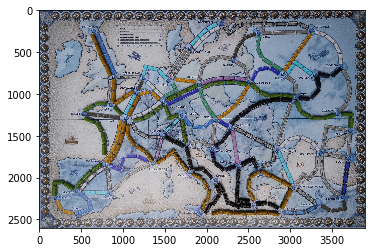

In [4]:
#img = cv2.imread("black_red_yellow.jpg")
#img_g = cv2.imread("black_red_yellow.jpg", 0)
img = cv.imread("black_blue_green.jpg")
#img_g = cv2.imread("black_red_yellow.jpg", 0)
#img = cv.imread("all_not_clean.jpg")
#img_g = cv.imread("all_not_clean.jpg", 0)
plt.imshow(img)

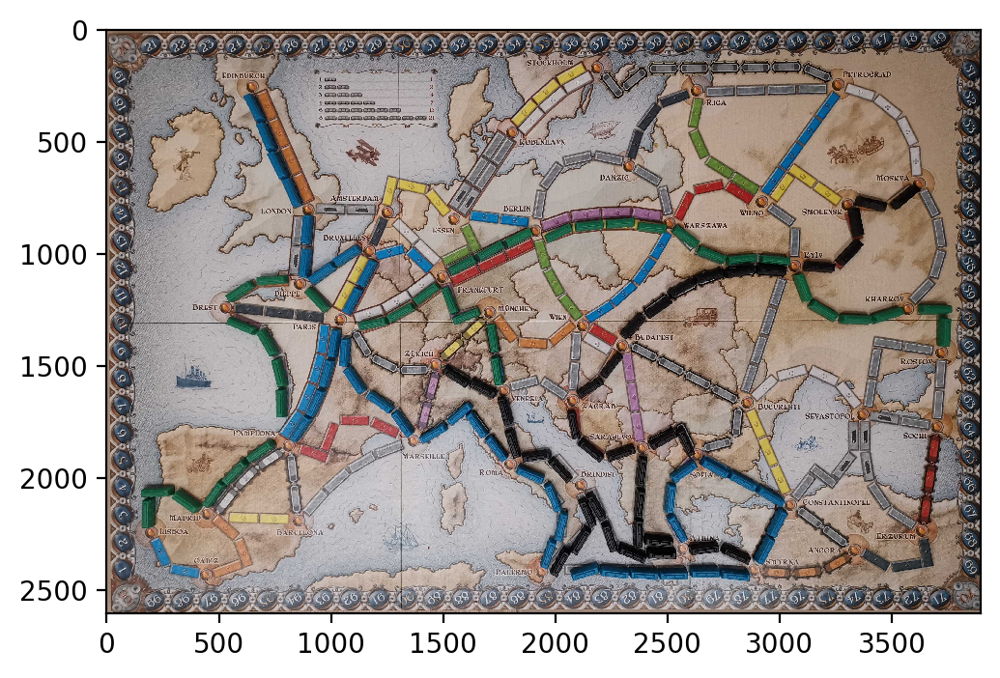

In [5]:
# img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = img[..., ::-1] #it' the same

plt.figure(dpi=200)
plt.imshow(img)

In [6]:
HLS = cv.cvtColor(img, cv.COLOR_RGB2HLS)


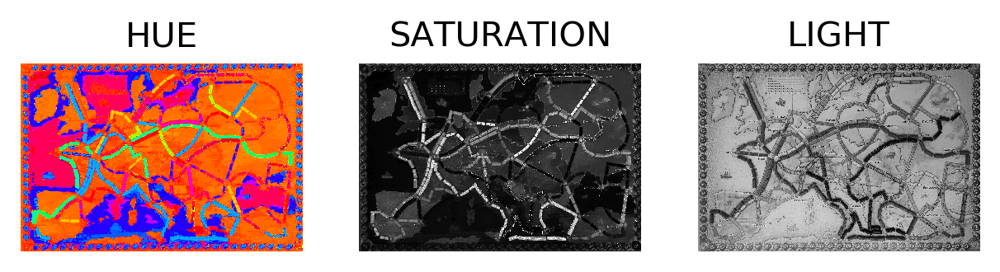

In [7]:
HUE = HLS[:, :, 0]              # Split attributes
LIGHT = HLS[:, :, 1]
SAT = HLS[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(HUE, cmap='hsv')
plt.title('HUE')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(SAT, cmap='gray')
plt.title('SATURATION')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(LIGHT, cmap='gray')
plt.title('LIGHT')
plt.axis('off')
plt.show()

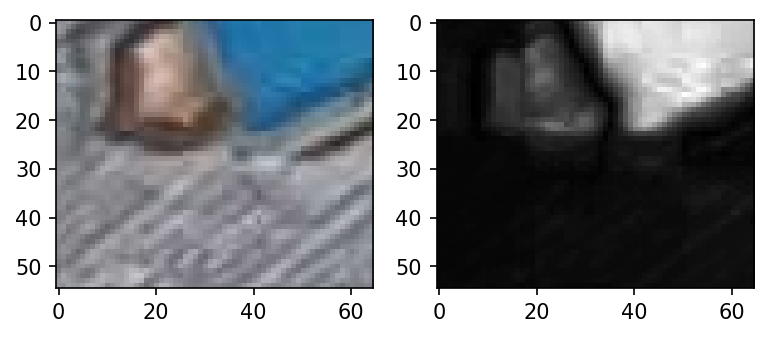

In [8]:
plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.imshow(img[2370:2425,210:275])
plt.subplot(1,2,2)     
plt.imshow(SAT[2370:2425,210:275], cmap="gray")

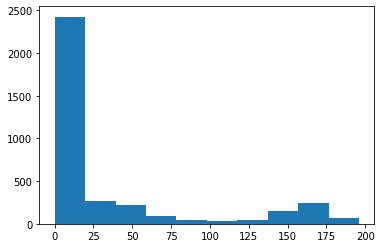

In [9]:
plt.hist(SAT[2370:2425,210:275].flatten());

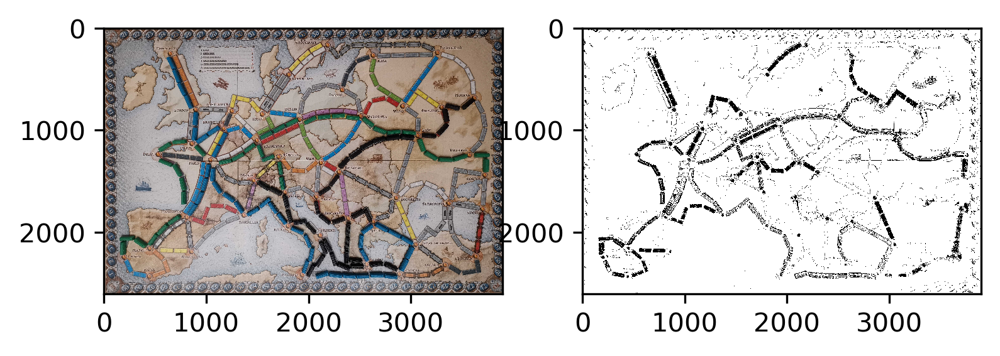

In [10]:
mask = (SAT < 90) | (SAT > 160)
img2 = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask, cmap="gray")

<Figure size 1200x800 with 0 Axes>

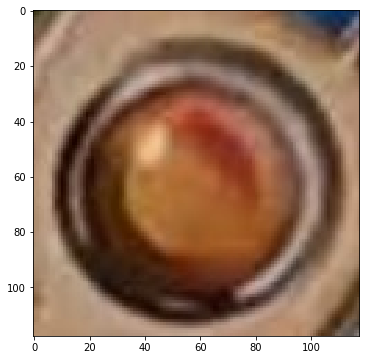

<class 'numpy.ndarray'>


In [43]:
template = cv.imread("template.jpg")
template = template[..., ::-1] #it' the same

plt.figure(dpi=200)

plot_img(template)
print(type(template))

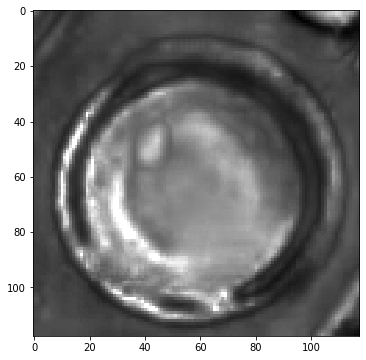

In [44]:
HLS_temp = cv.cvtColor(template, cv.COLOR_RGB2HLS)
#HUE = HLS[:, :, 0]              # Split attributes
#LIGHT = HLS[:, :, 1]
SAT_temp = HLS_temp[:, :, 2]
plot_img(SAT_temp)

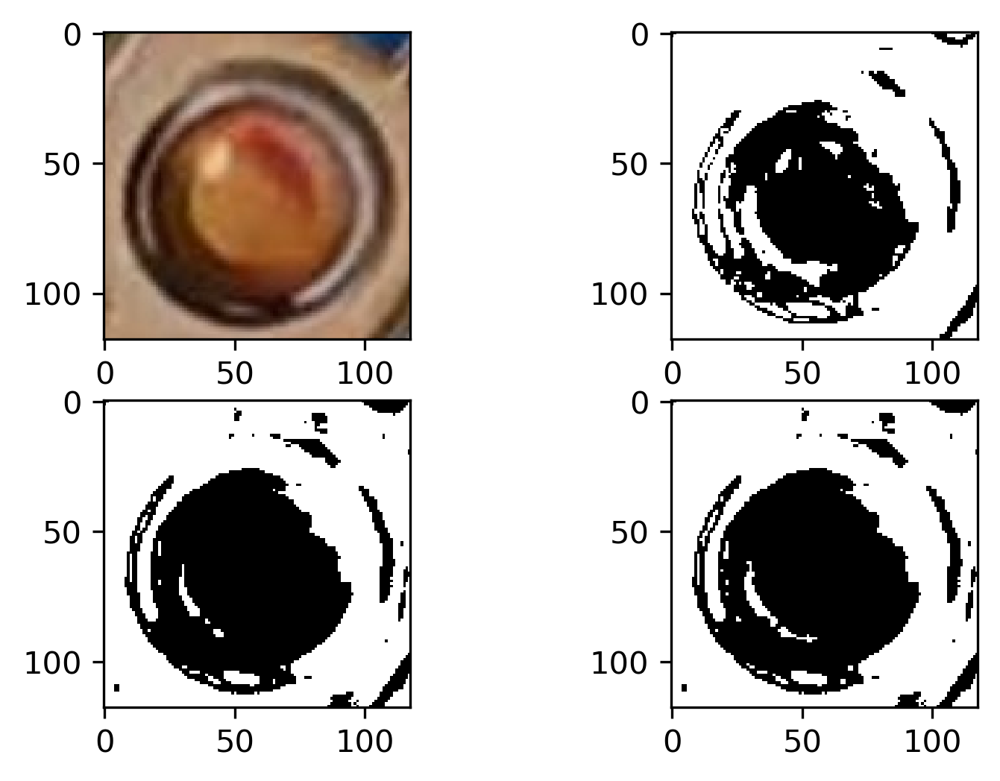

In [45]:
mask1 = (SAT_temp < 100) | (SAT_temp > 180)
mask2 = (SAT_temp < 90) | (SAT_temp > 250)
mask3 = (SAT_temp < 90) | (SAT_temp > 230)
template2 = template.copy()


plt.figure(dpi=300)
plt.subplot(2,2,1)   
# plt.axis('off')
plt.imshow(template2,cmap="gray")
plt.subplot(2,2,2)     
# plt.axis('off')
plt.imshow(mask1, cmap="gray")
plt.subplot(2,2,3)     
# plt.axis('off')
plt.imshow(mask2, cmap="gray")
plt.subplot(2,2,4)     
# plt.axis('off')
plt.imshow(mask3, cmap="gray")

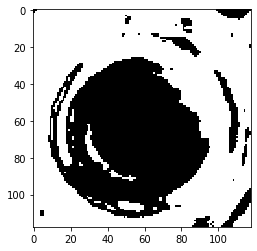

In [46]:
img2[mask] = 0
mask_temp = mask3
plt.imshow(mask_temp, cmap="gray")


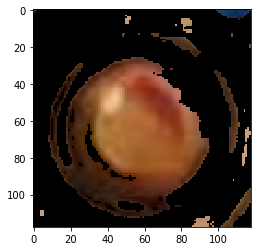

In [47]:
template[mask3] = 0
plt.imshow(template, cmap="gray")



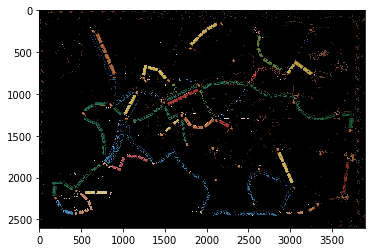

In [48]:
plt.imshow(img2, cmap="gray")


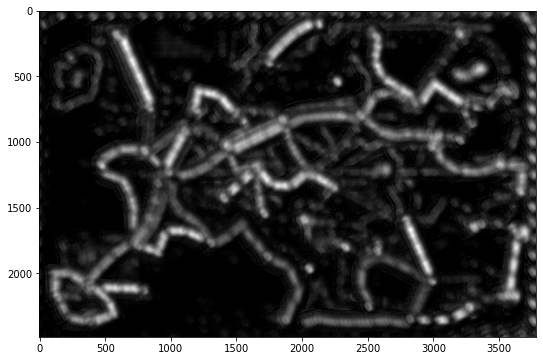

In [49]:
res = cv.matchTemplate(img2,template,3)
min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
plot_img(res)

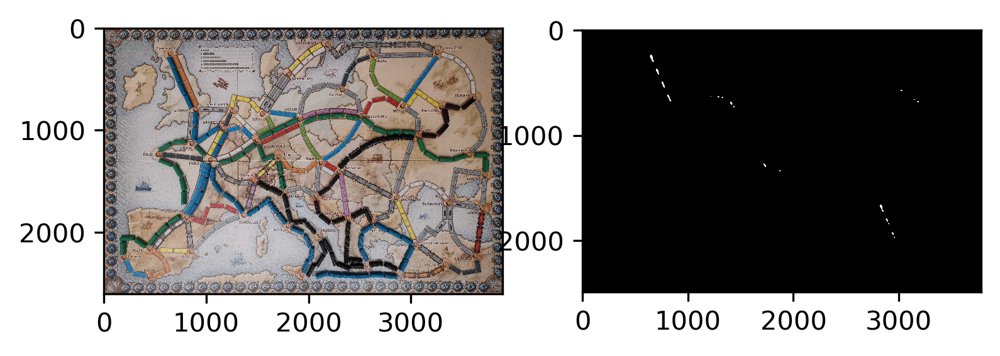

In [51]:
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(res>0.62,cmap="gray")


In [129]:
from skimage.measure import label
def get_local_centers(corr,th=0.62):
    lbl, n = label(corr >= th, connectivity = 2, return_num=True)
    print(n)
    return np.int16([np.mean(np.argwhere(lbl == i),axis =0) for i in range(1, n+1)])

cities = get_local_centers(res)

74


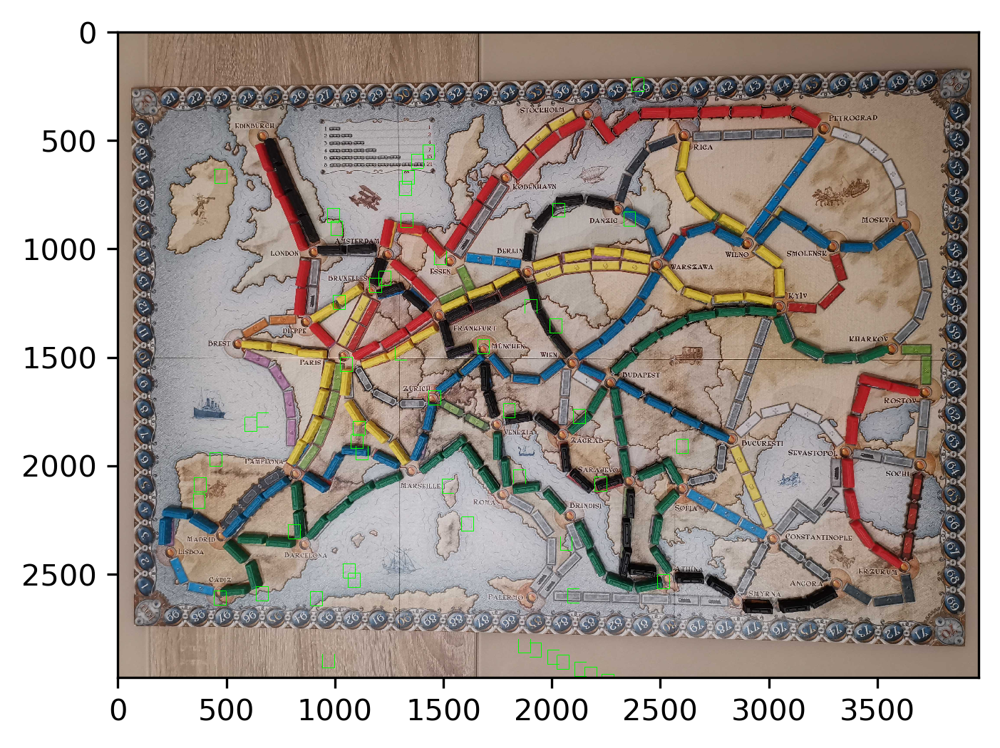

In [133]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
threshold = 0.70
w, h = temp.shape[0:2]
loc = np.where( res >= threshold)
for pt in cities:
    pt = (pt[0],pt[1])
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

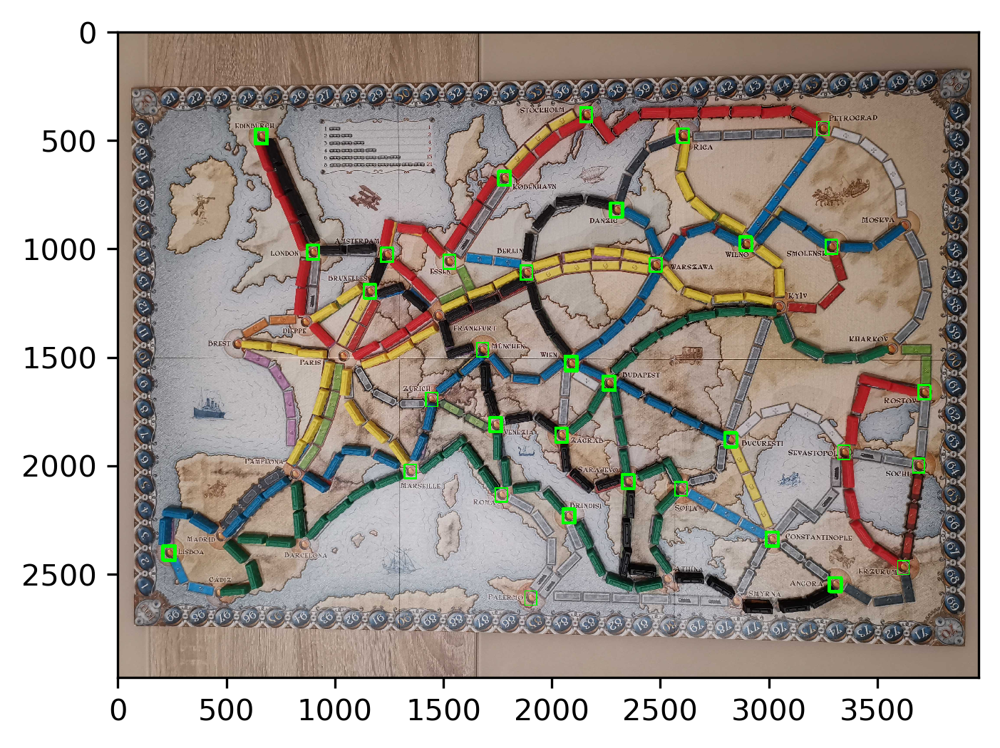

In [64]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
threshold = 0.70
w, h = temp.shape[0:2]
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

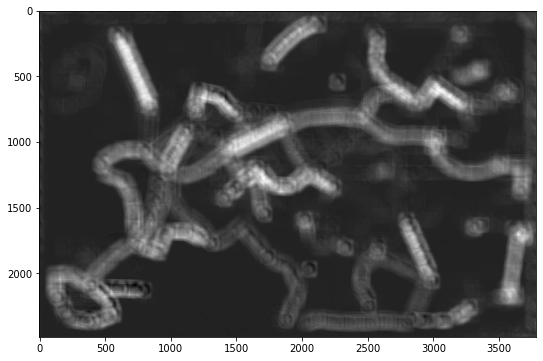

In [52]:
res = cv.matchTemplate(img2,temp,0)
min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
plot_img(1-res)

In [174]:
1-res

array([[-33465516., -33465516., -33465516., ..., -33465516., -33465516.,
        -33465516.],
       [-33465516., -33465516., -33465516., ..., -33465516., -33465516.,
        -33465516.],
       [-33465516., -33465516., -33465516., ..., -33465516., -33465516.,
        -33465516.],
       ...,
       [-33465516., -33465516., -33465516., ..., -33465516., -33465516.,
        -33465516.],
       [-33465516., -33465516., -33465516., ..., -33465516., -33465516.,
        -33465516.],
       [-33465516., -33465516., -33465516., ..., -33465516., -33465516.,
        -33465516.]], dtype=float32)

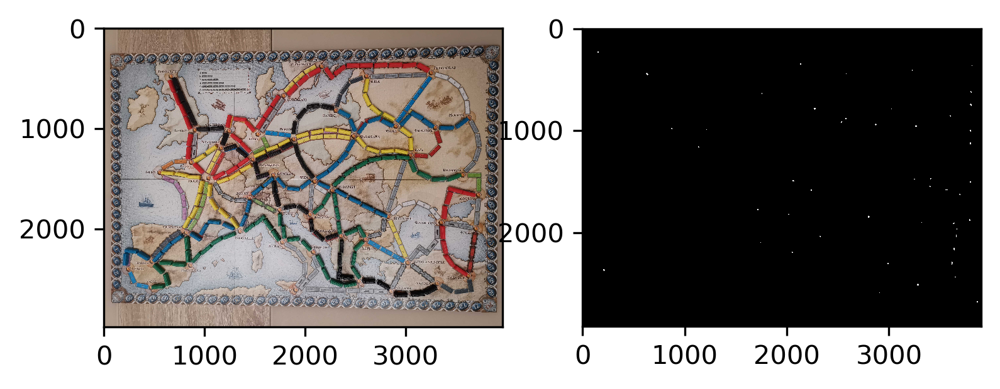

In [175]:
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(res<25000000,cmap="gray")

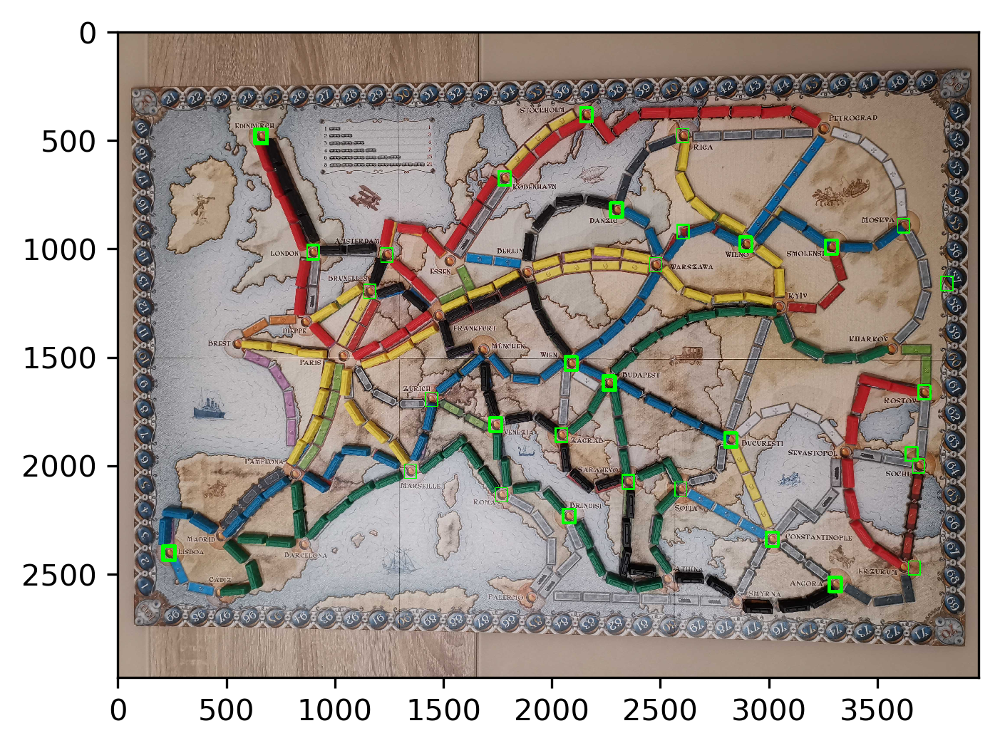

In [176]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
threshold = 21500000
w, h = temp.shape[0:2]
loc = np.where( res <= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

In [177]:
from skimage.measure import label
def get_local_centers(corr,th=21500000):
    lbl, n = label(corr <= th, connectivity = 2, return_num=True)
    print(n)
    return np.int16([np.mean(np.argwhere(lbl == i),axis =0) for i in range(1, n+1)])

img_res = np.ascontiguousarray(img, dtype=np.uint8)
cities = get_local_centers(res)

33


In [227]:
loc = np.where( res <= threshold)
len(loc[1])
x = loc[0][0]
y = loc[1][0]
points = [[x,y]]
print(len(points), points)
for i in range(len(loc[1])):
    x1 = loc[0][i]
    y1 = loc[1][i]
    print("x1 y1 ", x1,y1)
    counter = 0
    for j in range(len(points)):
        print(len(points), "entering second loop len")
        x = points[j][0]
        y = points[j][1]
        print("difference x" , x1-x, "difference y:", y1-y)
        if abs(x1-x)>30 or abs(y1-y)>30:
            counter+=1
            print("add to counter")
    print("counter:", counter, "exited second loop len : ", len(points))
    if counter==len(points):
        points.append([x1,y1])
        #x = x1
        #y = y1

print(points)
        

               

1 [[344, 2130]]
x1 y1  344 2130
1 entering second loop len
difference x 0 difference y: 0
counter: 0 exited second loop len :  1
x1 y1  344 2131
1 entering second loop len
difference x 0 difference y: 1
counter: 0 exited second loop len :  1
x1 y1  344 2132
1 entering second loop len
difference x 0 difference y: 2
counter: 0 exited second loop len :  1
x1 y1  345 2129
1 entering second loop len
difference x 1 difference y: -1
counter: 0 exited second loop len :  1
x1 y1  345 2130
1 entering second loop len
difference x 1 difference y: 0
counter: 0 exited second loop len :  1
x1 y1  345 2131
1 entering second loop len
difference x 1 difference y: 1
counter: 0 exited second loop len :  1
x1 y1  345 2132
1 entering second loop len
difference x 1 difference y: 2
counter: 0 exited second loop len :  1
x1 y1  345 2133
1 entering second loop len
difference x 1 difference y: 3
counter: 0 exited second loop len :  1
x1 y1  346 2128
1 entering second loop len
difference x 2 difference y: -2
coun

difference x 101 difference y: 448
add to counter
3 entering second loop len
difference x 5 difference y: 1948
add to counter
3 entering second loop len
difference x 2 difference y: 0
counter: 2 exited second loop len :  3
x1 y1  446 626
3 entering second loop len
difference x 102 difference y: -1504
add to counter
3 entering second loop len
difference x 6 difference y: -4
3 entering second loop len
difference x 3 difference y: -1952
add to counter
counter: 2 exited second loop len :  3
x1 y1  446 627
3 entering second loop len
difference x 102 difference y: -1503
add to counter
3 entering second loop len
difference x 6 difference y: -3
3 entering second loop len
difference x 3 difference y: -1951
add to counter
counter: 2 exited second loop len :  3
x1 y1  446 628
3 entering second loop len
difference x 102 difference y: -1502
add to counter
3 entering second loop len
difference x 6 difference y: -2
3 entering second loop len
difference x 3 difference y: -1950
add to counter
counter: 

3 entering second loop len
difference x 11 difference y: 6
3 entering second loop len
difference x 8 difference y: -1942
add to counter
counter: 2 exited second loop len :  3
x1 y1  451 637
3 entering second loop len
difference x 107 difference y: -1493
add to counter
3 entering second loop len
difference x 11 difference y: 7
3 entering second loop len
difference x 8 difference y: -1941
add to counter
counter: 2 exited second loop len :  3
x1 y1  451 638
3 entering second loop len
difference x 107 difference y: -1492
add to counter
3 entering second loop len
difference x 11 difference y: 8
3 entering second loop len
difference x 8 difference y: -1940
add to counter
counter: 2 exited second loop len :  3
x1 y1  451 639
3 entering second loop len
difference x 107 difference y: -1491
add to counter
3 entering second loop len
difference x 11 difference y: 9
3 entering second loop len
difference x 8 difference y: -1939
add to counter
counter: 2 exited second loop len :  3
x1 y1  451 640
3 e

4 entering second loop len
difference x 201 difference y: 1127
add to counter
4 entering second loop len
difference x 198 difference y: -821
add to counter
4 entering second loop len
difference x 4 difference y: 3
counter: 3 exited second loop len :  4
x1 y1  641 1758
4 entering second loop len
difference x 297 difference y: -372
add to counter
4 entering second loop len
difference x 201 difference y: 1128
add to counter
4 entering second loop len
difference x 198 difference y: -820
add to counter
4 entering second loop len
difference x 4 difference y: 4
counter: 3 exited second loop len :  4
x1 y1  641 1759
4 entering second loop len
difference x 297 difference y: -371
add to counter
4 entering second loop len
difference x 201 difference y: 1129
add to counter
4 entering second loop len
difference x 198 difference y: -819
add to counter
4 entering second loop len
difference x 4 difference y: 5
counter: 3 exited second loop len :  4
x1 y1  642 1752
4 entering second loop len
difference

difference x 342 difference y: -312
add to counter
5 entering second loop len
difference x 148 difference y: 512
add to counter
5 entering second loop len
difference x 4 difference y: -3
counter: 4 exited second loop len :  5
x1 y1  785 2267
5 entering second loop len
difference x 441 difference y: 137
add to counter
5 entering second loop len
difference x 345 difference y: 1637
add to counter
5 entering second loop len
difference x 342 difference y: -311
add to counter
5 entering second loop len
difference x 148 difference y: 513
add to counter
5 entering second loop len
difference x 4 difference y: -2
counter: 4 exited second loop len :  5
x1 y1  785 2268
5 entering second loop len
difference x 441 difference y: 138
add to counter
5 entering second loop len
difference x 345 difference y: 1638
add to counter
5 entering second loop len
difference x 342 difference y: -310
add to counter
5 entering second loop len
difference x 148 difference y: 514
add to counter
5 entering second loop l

difference x 8 difference y: 2
counter: 4 exited second loop len :  5
x1 y1  789 2272
5 entering second loop len
difference x 445 difference y: 142
add to counter
5 entering second loop len
difference x 349 difference y: 1642
add to counter
5 entering second loop len
difference x 346 difference y: -306
add to counter
5 entering second loop len
difference x 152 difference y: 518
add to counter
5 entering second loop len
difference x 8 difference y: 3
counter: 4 exited second loop len :  5
x1 y1  789 2273
5 entering second loop len
difference x 445 difference y: 143
add to counter
5 entering second loop len
difference x 349 difference y: 1643
add to counter
5 entering second loop len
difference x 346 difference y: -305
add to counter
5 entering second loop len
difference x 152 difference y: 519
add to counter
5 entering second loop len
difference x 8 difference y: 4
counter: 4 exited second loop len :  5
x1 y1  789 2274
5 entering second loop len
difference x 445 difference y: 144
add to

difference x 247 difference y: 822
add to counter
7 entering second loop len
difference x 103 difference y: 307
add to counter
7 entering second loop len
difference x 27 difference y: -1018
add to counter
7 entering second loop len
difference x 0 difference y: 1
counter: 6 exited second loop len :  7
x1 y1  888 2579
7 entering second loop len
difference x 544 difference y: 449
add to counter
7 entering second loop len
difference x 448 difference y: 1949
add to counter
7 entering second loop len
difference x 445 difference y: 1
add to counter
7 entering second loop len
difference x 251 difference y: 825
add to counter
7 entering second loop len
difference x 107 difference y: 310
add to counter
7 entering second loop len
difference x 31 difference y: -1015
add to counter
7 entering second loop len
difference x 4 difference y: 4
counter: 6 exited second loop len :  7
x1 y1  888 2580
7 entering second loop len
difference x 544 difference y: 450
add to counter
7 entering second loop len
dif

difference x 498 difference y: 289
add to counter
8 entering second loop len
difference x 304 difference y: 1113
add to counter
8 entering second loop len
difference x 160 difference y: 598
add to counter
8 entering second loop len
difference x 84 difference y: -727
add to counter
8 entering second loop len
difference x 57 difference y: 292
add to counter
8 entering second loop len
difference x 4 difference y: 1
counter: 7 exited second loop len :  8
x1 y1  941 2868
8 entering second loop len
difference x 597 difference y: 738
add to counter
8 entering second loop len
difference x 501 difference y: 2238
add to counter
8 entering second loop len
difference x 498 difference y: 290
add to counter
8 entering second loop len
difference x 304 difference y: 1114
add to counter
8 entering second loop len
difference x 160 difference y: 599
add to counter
8 entering second loop len
difference x 84 difference y: -726
add to counter
8 entering second loop len
difference x 57 difference y: 293
add 

difference x 504 difference y: 2242
add to counter
8 entering second loop len
difference x 501 difference y: 294
add to counter
8 entering second loop len
difference x 307 difference y: 1118
add to counter
8 entering second loop len
difference x 163 difference y: 603
add to counter
8 entering second loop len
difference x 87 difference y: -722
add to counter
8 entering second loop len
difference x 60 difference y: 297
add to counter
8 entering second loop len
difference x 7 difference y: 6
counter: 7 exited second loop len :  8
x1 y1  944 2873
8 entering second loop len
difference x 600 difference y: 743
add to counter
8 entering second loop len
difference x 504 difference y: 2243
add to counter
8 entering second loop len
difference x 501 difference y: 295
add to counter
8 entering second loop len
difference x 307 difference y: 1119
add to counter
8 entering second loop len
difference x 163 difference y: 604
add to counter
8 entering second loop len
difference x 87 difference y: -721
ad

8 entering second loop len
difference x 168 difference y: 596
add to counter
8 entering second loop len
difference x 92 difference y: -729
add to counter
8 entering second loop len
difference x 65 difference y: 290
add to counter
8 entering second loop len
difference x 12 difference y: -1
counter: 7 exited second loop len :  8
x1 y1  949 2866
8 entering second loop len
difference x 605 difference y: 736
add to counter
8 entering second loop len
difference x 509 difference y: 2236
add to counter
8 entering second loop len
difference x 506 difference y: 288
add to counter
8 entering second loop len
difference x 312 difference y: 1112
add to counter
8 entering second loop len
difference x 168 difference y: 597
add to counter
8 entering second loop len
difference x 92 difference y: -728
add to counter
8 entering second loop len
difference x 65 difference y: 291
add to counter
8 entering second loop len
difference x 12 difference y: 0
counter: 7 exited second loop len :  8
x1 y1  949 2867
8

9 entering second loop len
difference x 175 difference y: 995
add to counter
9 entering second loop len
difference x 99 difference y: -330
add to counter
9 entering second loop len
difference x 72 difference y: 689
add to counter
9 entering second loop len
difference x 19 difference y: 398
add to counter
9 entering second loop len
difference x 3 difference y: 4
counter: 8 exited second loop len :  9
x1 y1  956 3265
9 entering second loop len
difference x 612 difference y: 1135
add to counter
9 entering second loop len
difference x 516 difference y: 2635
add to counter
9 entering second loop len
difference x 513 difference y: 687
add to counter
9 entering second loop len
difference x 319 difference y: 1511
add to counter
9 entering second loop len
difference x 175 difference y: 996
add to counter
9 entering second loop len
difference x 99 difference y: -329
add to counter
9 entering second loop len
difference x 72 difference y: 690
add to counter
9 entering second loop len
difference x 

counter: 8 exited second loop len :  9
x1 y1  960 3257
9 entering second loop len
difference x 616 difference y: 1127
add to counter
9 entering second loop len
difference x 520 difference y: 2627
add to counter
9 entering second loop len
difference x 517 difference y: 679
add to counter
9 entering second loop len
difference x 323 difference y: 1503
add to counter
9 entering second loop len
difference x 179 difference y: 988
add to counter
9 entering second loop len
difference x 103 difference y: -337
add to counter
9 entering second loop len
difference x 76 difference y: 682
add to counter
9 entering second loop len
difference x 23 difference y: 391
add to counter
9 entering second loop len
difference x 7 difference y: -3
counter: 8 exited second loop len :  9
x1 y1  960 3258
9 entering second loop len
difference x 616 difference y: 1128
add to counter
9 entering second loop len
difference x 520 difference y: 2628
add to counter
9 entering second loop len
difference x 517 difference y:

difference x 619 difference y: 1134
add to counter
9 entering second loop len
difference x 523 difference y: 2634
add to counter
9 entering second loop len
difference x 520 difference y: 686
add to counter
9 entering second loop len
difference x 326 difference y: 1510
add to counter
9 entering second loop len
difference x 182 difference y: 995
add to counter
9 entering second loop len
difference x 106 difference y: -330
add to counter
9 entering second loop len
difference x 79 difference y: 689
add to counter
9 entering second loop len
difference x 26 difference y: 398
add to counter
9 entering second loop len
difference x 10 difference y: 4
counter: 8 exited second loop len :  9
x1 y1  963 3265
9 entering second loop len
difference x 619 difference y: 1135
add to counter
9 entering second loop len
difference x 523 difference y: 2635
add to counter
9 entering second loop len
difference x 520 difference y: 687
add to counter
9 entering second loop len
difference x 326 difference y: 1511

difference x 99 difference y: -1704
add to counter
10 entering second loop len
difference x 46 difference y: -1995
add to counter
10 entering second loop len
difference x 30 difference y: -2389
add to counter
10 entering second loop len
difference x 5 difference y: -1
counter: 9 exited second loop len :  10
x1 y1  983 872
10 entering second loop len
difference x 639 difference y: -1258
add to counter
10 entering second loop len
difference x 543 difference y: 242
add to counter
10 entering second loop len
difference x 540 difference y: -1706
add to counter
10 entering second loop len
difference x 346 difference y: -882
add to counter
10 entering second loop len
difference x 202 difference y: -1397
add to counter
10 entering second loop len
difference x 126 difference y: -2722
add to counter
10 entering second loop len
difference x 99 difference y: -1703
add to counter
10 entering second loop len
difference x 46 difference y: -1994
add to counter
10 entering second loop len
difference x 

11 entering second loop len
difference x 359 difference y: -541
add to counter
11 entering second loop len
difference x 215 difference y: -1056
add to counter
11 entering second loop len
difference x 139 difference y: -2381
add to counter
11 entering second loop len
difference x 112 difference y: -1362
add to counter
11 entering second loop len
difference x 59 difference y: -1653
add to counter
11 entering second loop len
difference x 43 difference y: -2047
add to counter
11 entering second loop len
difference x 18 difference y: 341
add to counter
11 entering second loop len
difference x 3 difference y: 1
counter: 10 exited second loop len :  11
x1 y1  996 1214
11 entering second loop len
difference x 652 difference y: -916
add to counter
11 entering second loop len
difference x 556 difference y: 584
add to counter
11 entering second loop len
difference x 553 difference y: -1364
add to counter
11 entering second loop len
difference x 359 difference y: -540
add to counter
11 entering se

14 entering second loop len
difference x 208 difference y: -2127
add to counter
14 entering second loop len
difference x 183 difference y: 261
add to counter
14 entering second loop len
difference x 168 difference y: -79
add to counter
14 entering second loop len
difference x 121 difference y: -1318
add to counter
14 entering second loop len
difference x 37 difference y: -2660
add to counter
14 entering second loop len
difference x 1 difference y: 0
counter: 13 exited second loop len :  14
x1 y1  1161 1134
14 entering second loop len
difference x 817 difference y: -996
add to counter
14 entering second loop len
difference x 721 difference y: 504
add to counter
14 entering second loop len
difference x 718 difference y: -1444
add to counter
14 entering second loop len
difference x 524 difference y: -620
add to counter
14 entering second loop len
difference x 380 difference y: -1135
add to counter
14 entering second loop len
difference x 304 difference y: -2460
add to counter
14 entering 

add to counter
15 entering second loop len
difference x 366 difference y: -1733
add to counter
15 entering second loop len
difference x 330 difference y: 927
add to counter
15 entering second loop len
difference x 1 difference y: 0
counter: 14 exited second loop len :  15
x1 y1  1490 2061
15 entering second loop len
difference x 1146 difference y: -69
add to counter
15 entering second loop len
difference x 1050 difference y: 1431
add to counter
15 entering second loop len
difference x 1047 difference y: -517
add to counter
15 entering second loop len
difference x 853 difference y: 307
add to counter
15 entering second loop len
difference x 709 difference y: -208
add to counter
15 entering second loop len
difference x 633 difference y: -1533
add to counter
15 entering second loop len
difference x 606 difference y: -514
add to counter
15 entering second loop len
difference x 553 difference y: -805
add to counter
15 entering second loop len
difference x 537 difference y: -1199
add to coun

15 entering second loop len
difference x 635 difference y: -1528
add to counter
15 entering second loop len
difference x 608 difference y: -509
add to counter
15 entering second loop len
difference x 555 difference y: -800
add to counter
15 entering second loop len
difference x 539 difference y: -1194
add to counter
15 entering second loop len
difference x 514 difference y: 1194
add to counter
15 entering second loop len
difference x 499 difference y: 854
add to counter
15 entering second loop len
difference x 452 difference y: -385
add to counter
15 entering second loop len
difference x 368 difference y: -1727
add to counter
15 entering second loop len
difference x 332 difference y: 933
add to counter
15 entering second loop len
difference x 3 difference y: 6
counter: 14 exited second loop len :  15
x1 y1  1493 2057
15 entering second loop len
difference x 1149 difference y: -73
add to counter
15 entering second loop len
difference x 1053 difference y: 1427
add to counter
15 entering 

15 entering second loop len
difference x 610 difference y: -508
add to counter
15 entering second loop len
difference x 557 difference y: -799
add to counter
15 entering second loop len
difference x 541 difference y: -1193
add to counter
15 entering second loop len
difference x 516 difference y: 1195
add to counter
15 entering second loop len
difference x 501 difference y: 855
add to counter
15 entering second loop len
difference x 454 difference y: -384
add to counter
15 entering second loop len
difference x 370 difference y: -1726
add to counter
15 entering second loop len
difference x 334 difference y: 934
add to counter
15 entering second loop len
difference x 5 difference y: 7
counter: 14 exited second loop len :  15
x1 y1  1495 2057
15 entering second loop len
difference x 1151 difference y: -73
add to counter
15 entering second loop len
difference x 1055 difference y: 1427
add to counter
15 entering second loop len
difference x 1052 difference y: -521
add to counter
15 entering 

difference x 503 difference y: 854
add to counter
15 entering second loop len
difference x 456 difference y: -385
add to counter
15 entering second loop len
difference x 372 difference y: -1727
add to counter
15 entering second loop len
difference x 336 difference y: 933
add to counter
15 entering second loop len
difference x 7 difference y: 6
counter: 14 exited second loop len :  15
x1 y1  1496 2067
15 entering second loop len
difference x 1152 difference y: -63
add to counter
15 entering second loop len
difference x 1056 difference y: 1437
add to counter
15 entering second loop len
difference x 1053 difference y: -511
add to counter
15 entering second loop len
difference x 859 difference y: 313
add to counter
15 entering second loop len
difference x 715 difference y: -202
add to counter
15 entering second loop len
difference x 639 difference y: -1527
add to counter
15 entering second loop len
difference x 612 difference y: -508
add to counter
15 entering second loop len
difference x 

difference x 338 difference y: 934
add to counter
15 entering second loop len
difference x 9 difference y: 7
counter: 14 exited second loop len :  15
x1 y1  1499 2059
15 entering second loop len
difference x 1155 difference y: -71
add to counter
15 entering second loop len
difference x 1059 difference y: 1429
add to counter
15 entering second loop len
difference x 1056 difference y: -519
add to counter
15 entering second loop len
difference x 862 difference y: 305
add to counter
15 entering second loop len
difference x 718 difference y: -210
add to counter
15 entering second loop len
difference x 642 difference y: -1535
add to counter
15 entering second loop len
difference x 615 difference y: -516
add to counter
15 entering second loop len
difference x 562 difference y: -807
add to counter
15 entering second loop len
difference x 546 difference y: -1201
add to counter
15 entering second loop len
difference x 521 difference y: 1187
add to counter
15 entering second loop len
difference x

difference x 943 difference y: 480
add to counter
16 entering second loop len
difference x 799 difference y: -35
add to counter
16 entering second loop len
difference x 723 difference y: -1360
add to counter
16 entering second loop len
difference x 696 difference y: -341
add to counter
16 entering second loop len
difference x 643 difference y: -632
add to counter
16 entering second loop len
difference x 627 difference y: -1026
add to counter
16 entering second loop len
difference x 602 difference y: 1362
add to counter
16 entering second loop len
difference x 587 difference y: 1022
add to counter
16 entering second loop len
difference x 540 difference y: -217
add to counter
16 entering second loop len
difference x 456 difference y: -1559
add to counter
16 entering second loop len
difference x 420 difference y: 1101
add to counter
16 entering second loop len
difference x 91 difference y: 174
add to counter
16 entering second loop len
difference x 1 difference y: -1
counter: 15 exited se

16 entering second loop len
difference x 589 difference y: 1028
add to counter
16 entering second loop len
difference x 542 difference y: -211
add to counter
16 entering second loop len
difference x 458 difference y: -1553
add to counter
16 entering second loop len
difference x 422 difference y: 1107
add to counter
16 entering second loop len
difference x 93 difference y: 180
add to counter
16 entering second loop len
difference x 3 difference y: 5
counter: 15 exited second loop len :  16
x1 y1  1583 2231
16 entering second loop len
difference x 1239 difference y: 101
add to counter
16 entering second loop len
difference x 1143 difference y: 1601
add to counter
16 entering second loop len
difference x 1140 difference y: -347
add to counter
16 entering second loop len
difference x 946 difference y: 477
add to counter
16 entering second loop len
difference x 802 difference y: -38
add to counter
16 entering second loop len
difference x 726 difference y: -1363
add to counter
16 entering se

difference x 460 difference y: -1555
add to counter
16 entering second loop len
difference x 424 difference y: 1105
add to counter
16 entering second loop len
difference x 95 difference y: 178
add to counter
16 entering second loop len
difference x 5 difference y: 3
counter: 15 exited second loop len :  16
x1 y1  1584 2239
16 entering second loop len
difference x 1240 difference y: 109
add to counter
16 entering second loop len
difference x 1144 difference y: 1609
add to counter
16 entering second loop len
difference x 1141 difference y: -339
add to counter
16 entering second loop len
difference x 947 difference y: 485
add to counter
16 entering second loop len
difference x 803 difference y: -30
add to counter
16 entering second loop len
difference x 727 difference y: -1355
add to counter
16 entering second loop len
difference x 700 difference y: -336
add to counter
16 entering second loop len
difference x 647 difference y: -627
add to counter
16 entering second loop len
difference x 6

difference x 462 difference y: -1561
add to counter
16 entering second loop len
difference x 426 difference y: 1099
add to counter
16 entering second loop len
difference x 97 difference y: 172
add to counter
16 entering second loop len
difference x 7 difference y: -3
counter: 15 exited second loop len :  16
x1 y1  1586 2233
16 entering second loop len
difference x 1242 difference y: 103
add to counter
16 entering second loop len
difference x 1146 difference y: 1603
add to counter
16 entering second loop len
difference x 1143 difference y: -345
add to counter
16 entering second loop len
difference x 949 difference y: 479
add to counter
16 entering second loop len
difference x 805 difference y: -36
add to counter
16 entering second loop len
difference x 729 difference y: -1361
add to counter
16 entering second loop len
difference x 702 difference y: -342
add to counter
16 entering second loop len
difference x 649 difference y: -633
add to counter
16 entering second loop len
difference x 

16 entering second loop len
difference x 950 difference y: 483
add to counter
16 entering second loop len
difference x 806 difference y: -32
add to counter
16 entering second loop len
difference x 730 difference y: -1357
add to counter
16 entering second loop len
difference x 703 difference y: -338
add to counter
16 entering second loop len
difference x 650 difference y: -629
add to counter
16 entering second loop len
difference x 634 difference y: -1023
add to counter
16 entering second loop len
difference x 609 difference y: 1365
add to counter
16 entering second loop len
difference x 594 difference y: 1025
add to counter
16 entering second loop len
difference x 547 difference y: -214
add to counter
16 entering second loop len
difference x 463 difference y: -1556
add to counter
16 entering second loop len
difference x 427 difference y: 1104
add to counter
16 entering second loop len
difference x 98 difference y: 177
add to counter
16 entering second loop len
difference x 8 difference

add to counter
16 entering second loop len
difference x 610 difference y: 1371
add to counter
16 entering second loop len
difference x 595 difference y: 1031
add to counter
16 entering second loop len
difference x 548 difference y: -208
add to counter
16 entering second loop len
difference x 464 difference y: -1550
add to counter
16 entering second loop len
difference x 428 difference y: 1110
add to counter
16 entering second loop len
difference x 99 difference y: 183
add to counter
16 entering second loop len
difference x 9 difference y: 8
counter: 15 exited second loop len :  16
x1 y1  1588 2244
16 entering second loop len
difference x 1244 difference y: 114
add to counter
16 entering second loop len
difference x 1148 difference y: 1614
add to counter
16 entering second loop len
difference x 1145 difference y: -334
add to counter
16 entering second loop len
difference x 951 difference y: 490
add to counter
16 entering second loop len
difference x 807 difference y: -25
add to counter


16 entering second loop len
difference x 1150 difference y: 1609
add to counter
16 entering second loop len
difference x 1147 difference y: -339
add to counter
16 entering second loop len
difference x 953 difference y: 485
add to counter
16 entering second loop len
difference x 809 difference y: -30
add to counter
16 entering second loop len
difference x 733 difference y: -1355
add to counter
16 entering second loop len
difference x 706 difference y: -336
add to counter
16 entering second loop len
difference x 653 difference y: -627
add to counter
16 entering second loop len
difference x 637 difference y: -1021
add to counter
16 entering second loop len
difference x 612 difference y: 1367
add to counter
16 entering second loop len
difference x 597 difference y: 1027
add to counter
16 entering second loop len
difference x 550 difference y: -212
add to counter
16 entering second loop len
difference x 466 difference y: -1554
add to counter
16 entering second loop len
difference x 430 diff

difference x 614 difference y: 1368
add to counter
16 entering second loop len
difference x 599 difference y: 1028
add to counter
16 entering second loop len
difference x 552 difference y: -211
add to counter
16 entering second loop len
difference x 468 difference y: -1553
add to counter
16 entering second loop len
difference x 432 difference y: 1107
add to counter
16 entering second loop len
difference x 103 difference y: 180
add to counter
16 entering second loop len
difference x 13 difference y: 5
counter: 15 exited second loop len :  16
x1 y1  1592 2241
16 entering second loop len
difference x 1248 difference y: 111
add to counter
16 entering second loop len
difference x 1152 difference y: 1611
add to counter
16 entering second loop len
difference x 1149 difference y: -337
add to counter
16 entering second loop len
difference x 955 difference y: 487
add to counter
16 entering second loop len
difference x 811 difference y: -28
add to counter
16 entering second loop len
difference x 

difference x 990 difference y: 1938
add to counter
17 entering second loop len
difference x 846 difference y: 1423
add to counter
17 entering second loop len
difference x 770 difference y: 98
add to counter
17 entering second loop len
difference x 743 difference y: 1117
add to counter
17 entering second loop len
difference x 690 difference y: 826
add to counter
17 entering second loop len
difference x 674 difference y: 432
add to counter
17 entering second loop len
difference x 649 difference y: 2820
add to counter
17 entering second loop len
difference x 634 difference y: 2480
add to counter
17 entering second loop len
difference x 587 difference y: 1241
add to counter
17 entering second loop len
difference x 503 difference y: -101
add to counter
17 entering second loop len
difference x 467 difference y: 2559
add to counter
17 entering second loop len
difference x 138 difference y: 1632
add to counter
17 entering second loop len
difference x 48 difference y: 1457
add to counter
17 ent

difference x 667 difference y: 205
add to counter
18 entering second loop len
difference x 620 difference y: -1034
add to counter
18 entering second loop len
difference x 536 difference y: -2376
add to counter
18 entering second loop len
difference x 500 difference y: 284
add to counter
18 entering second loop len
difference x 171 difference y: -643
add to counter
18 entering second loop len
difference x 81 difference y: -818
add to counter
18 entering second loop len
difference x 35 difference y: -2271
add to counter
18 entering second loop len
difference x 1 difference y: -1
counter: 17 exited second loop len :  18
x1 y1  1660 1418
18 entering second loop len
difference x 1316 difference y: -712
add to counter
18 entering second loop len
difference x 1220 difference y: 788
add to counter
18 entering second loop len
difference x 1217 difference y: -1160
add to counter
18 entering second loop len
difference x 1023 difference y: -336
add to counter
18 entering second loop len
difference

difference x 890 difference y: -865
add to counter
19 entering second loop len
difference x 837 difference y: -1156
add to counter
19 entering second loop len
difference x 821 difference y: -1550
add to counter
19 entering second loop len
difference x 796 difference y: 838
add to counter
19 entering second loop len
difference x 781 difference y: 498
add to counter
19 entering second loop len
difference x 734 difference y: -741
add to counter
19 entering second loop len
difference x 650 difference y: -2083
add to counter
19 entering second loop len
difference x 614 difference y: 577
add to counter
19 entering second loop len
difference x 285 difference y: -350
add to counter
19 entering second loop len
difference x 195 difference y: -525
add to counter
19 entering second loop len
difference x 149 difference y: -1978
add to counter
19 entering second loop len
difference x 115 difference y: 292
add to counter
19 entering second loop len
difference x 2 difference y: -2
counter: 18 exited s

add to counter
19 entering second loop len
difference x 116 difference y: 300
add to counter
19 entering second loop len
difference x 3 difference y: 6
counter: 18 exited second loop len :  19
x1 y1  1775 1719
19 entering second loop len
difference x 1431 difference y: -411
add to counter
19 entering second loop len
difference x 1335 difference y: 1089
add to counter
19 entering second loop len
difference x 1332 difference y: -859
add to counter
19 entering second loop len
difference x 1138 difference y: -35
add to counter
19 entering second loop len
difference x 994 difference y: -550
add to counter
19 entering second loop len
difference x 918 difference y: -1875
add to counter
19 entering second loop len
difference x 891 difference y: -856
add to counter
19 entering second loop len
difference x 838 difference y: -1147
add to counter
19 entering second loop len
difference x 822 difference y: -1541
add to counter
19 entering second loop len
difference x 797 difference y: 847
add to cou

difference x 893 difference y: -861
add to counter
19 entering second loop len
difference x 840 difference y: -1152
add to counter
19 entering second loop len
difference x 824 difference y: -1546
add to counter
19 entering second loop len
difference x 799 difference y: 842
add to counter
19 entering second loop len
difference x 784 difference y: 502
add to counter
19 entering second loop len
difference x 737 difference y: -737
add to counter
19 entering second loop len
difference x 653 difference y: -2079
add to counter
19 entering second loop len
difference x 617 difference y: 581
add to counter
19 entering second loop len
difference x 288 difference y: -346
add to counter
19 entering second loop len
difference x 198 difference y: -521
add to counter
19 entering second loop len
difference x 152 difference y: -1974
add to counter
19 entering second loop len
difference x 118 difference y: 296
add to counter
19 entering second loop len
difference x 5 difference y: 2
counter: 18 exited se

19 entering second loop len
difference x 655 difference y: -2081
add to counter
19 entering second loop len
difference x 619 difference y: 579
add to counter
19 entering second loop len
difference x 290 difference y: -348
add to counter
19 entering second loop len
difference x 200 difference y: -523
add to counter
19 entering second loop len
difference x 154 difference y: -1976
add to counter
19 entering second loop len
difference x 120 difference y: 294
add to counter
19 entering second loop len
difference x 7 difference y: 0
counter: 18 exited second loop len :  19
x1 y1  1779 1713
19 entering second loop len
difference x 1435 difference y: -417
add to counter
19 entering second loop len
difference x 1339 difference y: 1083
add to counter
19 entering second loop len
difference x 1336 difference y: -865
add to counter
19 entering second loop len
difference x 1142 difference y: -41
add to counter
19 entering second loop len
difference x 998 difference y: -556
add to counter
19 entering

add to counter
19 entering second loop len
difference x 9 difference y: 2
counter: 18 exited second loop len :  19
x1 y1  1781 1715
19 entering second loop len
difference x 1437 difference y: -415
add to counter
19 entering second loop len
difference x 1341 difference y: 1085
add to counter
19 entering second loop len
difference x 1338 difference y: -863
add to counter
19 entering second loop len
difference x 1144 difference y: -39
add to counter
19 entering second loop len
difference x 1000 difference y: -554
add to counter
19 entering second loop len
difference x 924 difference y: -1879
add to counter
19 entering second loop len
difference x 897 difference y: -860
add to counter
19 entering second loop len
difference x 844 difference y: -1151
add to counter
19 entering second loop len
difference x 828 difference y: -1545
add to counter
19 entering second loop len
difference x 803 difference y: 843
add to counter
19 entering second loop len
difference x 788 difference y: 503
add to co

difference x 53 difference y: 307
add to counter
20 entering second loop len
difference x 2 difference y: 3
counter: 19 exited second loop len :  20
x1 y1  1825 2020
20 entering second loop len
difference x 1481 difference y: -110
add to counter
20 entering second loop len
difference x 1385 difference y: 1390
add to counter
20 entering second loop len
difference x 1382 difference y: -558
add to counter
20 entering second loop len
difference x 1188 difference y: 266
add to counter
20 entering second loop len
difference x 1044 difference y: -249
add to counter
20 entering second loop len
difference x 968 difference y: -1574
add to counter
20 entering second loop len
difference x 941 difference y: -555
add to counter
20 entering second loop len
difference x 888 difference y: -846
add to counter
20 entering second loop len
difference x 872 difference y: -1240
add to counter
20 entering second loop len
difference x 847 difference y: 1148
add to counter
20 entering second loop len
difference

21 entering second loop len
difference x 802 difference y: 343
add to counter
21 entering second loop len
difference x 718 difference y: -999
add to counter
21 entering second loop len
difference x 682 difference y: 1661
add to counter
21 entering second loop len
difference x 353 difference y: 734
add to counter
21 entering second loop len
difference x 263 difference y: 559
add to counter
21 entering second loop len
difference x 217 difference y: -894
add to counter
21 entering second loop len
difference x 183 difference y: 1376
add to counter
21 entering second loop len
difference x 70 difference y: 1082
add to counter
21 entering second loop len
difference x 19 difference y: 778
add to counter
21 entering second loop len
difference x 1 difference y: -1
counter: 20 exited second loop len :  21
x1 y1  1842 2795
21 entering second loop len
difference x 1498 difference y: 665
add to counter
21 entering second loop len
difference x 1402 difference y: 2165
add to counter
21 entering second

21 entering second loop len
difference x 355 difference y: 733
add to counter
21 entering second loop len
difference x 265 difference y: 558
add to counter
21 entering second loop len
difference x 219 difference y: -895
add to counter
21 entering second loop len
difference x 185 difference y: 1375
add to counter
21 entering second loop len
difference x 72 difference y: 1081
add to counter
21 entering second loop len
difference x 21 difference y: 777
add to counter
21 entering second loop len
difference x 3 difference y: -2
counter: 20 exited second loop len :  21
x1 y1  1844 2794
21 entering second loop len
difference x 1500 difference y: 664
add to counter
21 entering second loop len
difference x 1404 difference y: 2164
add to counter
21 entering second loop len
difference x 1401 difference y: 216
add to counter
21 entering second loop len
difference x 1207 difference y: 1040
add to counter
21 entering second loop len
difference x 1063 difference y: 525
add to counter
21 entering seco

difference x 186 difference y: 1380
add to counter
21 entering second loop len
difference x 73 difference y: 1086
add to counter
21 entering second loop len
difference x 22 difference y: 782
add to counter
21 entering second loop len
difference x 4 difference y: 3
counter: 20 exited second loop len :  21
x1 y1  1845 2799
21 entering second loop len
difference x 1501 difference y: 669
add to counter
21 entering second loop len
difference x 1405 difference y: 2169
add to counter
21 entering second loop len
difference x 1402 difference y: 221
add to counter
21 entering second loop len
difference x 1208 difference y: 1045
add to counter
21 entering second loop len
difference x 1064 difference y: 530
add to counter
21 entering second loop len
difference x 988 difference y: -795
add to counter
21 entering second loop len
difference x 961 difference y: 224
add to counter
21 entering second loop len
difference x 908 difference y: -67
add to counter
21 entering second loop len
difference x 892 

difference x 893 difference y: -458
add to counter
21 entering second loop len
difference x 868 difference y: 1930
add to counter
21 entering second loop len
difference x 853 difference y: 1590
add to counter
21 entering second loop len
difference x 806 difference y: 351
add to counter
21 entering second loop len
difference x 722 difference y: -991
add to counter
21 entering second loop len
difference x 686 difference y: 1669
add to counter
21 entering second loop len
difference x 357 difference y: 742
add to counter
21 entering second loop len
difference x 267 difference y: 567
add to counter
21 entering second loop len
difference x 221 difference y: -886
add to counter
21 entering second loop len
difference x 187 difference y: 1384
add to counter
21 entering second loop len
difference x 74 difference y: 1090
add to counter
21 entering second loop len
difference x 23 difference y: 786
add to counter
21 entering second loop len
difference x 5 difference y: 7
counter: 20 exited second l

add to counter
21 entering second loop len
difference x 1211 difference y: 1040
add to counter
21 entering second loop len
difference x 1067 difference y: 525
add to counter
21 entering second loop len
difference x 991 difference y: -800
add to counter
21 entering second loop len
difference x 964 difference y: 219
add to counter
21 entering second loop len
difference x 911 difference y: -72
add to counter
21 entering second loop len
difference x 895 difference y: -466
add to counter
21 entering second loop len
difference x 870 difference y: 1922
add to counter
21 entering second loop len
difference x 855 difference y: 1582
add to counter
21 entering second loop len
difference x 808 difference y: 343
add to counter
21 entering second loop len
difference x 724 difference y: -999
add to counter
21 entering second loop len
difference x 688 difference y: 1661
add to counter
21 entering second loop len
difference x 359 difference y: 734
add to counter
21 entering second loop len
difference x

difference x 224 difference y: -891
add to counter
21 entering second loop len
difference x 190 difference y: 1379
add to counter
21 entering second loop len
difference x 77 difference y: 1085
add to counter
21 entering second loop len
difference x 26 difference y: 781
add to counter
21 entering second loop len
difference x 8 difference y: 2
counter: 20 exited second loop len :  21
x1 y1  1849 2798
21 entering second loop len
difference x 1505 difference y: 668
add to counter
21 entering second loop len
difference x 1409 difference y: 2168
add to counter
21 entering second loop len
difference x 1406 difference y: 220
add to counter
21 entering second loop len
difference x 1212 difference y: 1044
add to counter
21 entering second loop len
difference x 1068 difference y: 529
add to counter
21 entering second loop len
difference x 992 difference y: -796
add to counter
21 entering second loop len
difference x 965 difference y: 223
add to counter
21 entering second loop len
difference x 912

add to counter
21 entering second loop len
difference x 225 difference y: -886
add to counter
21 entering second loop len
difference x 191 difference y: 1384
add to counter
21 entering second loop len
difference x 78 difference y: 1090
add to counter
21 entering second loop len
difference x 27 difference y: 786
add to counter
21 entering second loop len
difference x 9 difference y: 7
counter: 20 exited second loop len :  21
x1 y1  1850 2803
21 entering second loop len
difference x 1506 difference y: 673
add to counter
21 entering second loop len
difference x 1410 difference y: 2173
add to counter
21 entering second loop len
difference x 1407 difference y: 225
add to counter
21 entering second loop len
difference x 1213 difference y: 1049
add to counter
21 entering second loop len
difference x 1069 difference y: 534
add to counter
21 entering second loop len
difference x 993 difference y: -791
add to counter
21 entering second loop len
difference x 966 difference y: 228
add to counter
2

difference x 728 difference y: -996
add to counter
21 entering second loop len
difference x 692 difference y: 1664
add to counter
21 entering second loop len
difference x 363 difference y: 737
add to counter
21 entering second loop len
difference x 273 difference y: 562
add to counter
21 entering second loop len
difference x 227 difference y: -891
add to counter
21 entering second loop len
difference x 193 difference y: 1379
add to counter
21 entering second loop len
difference x 80 difference y: 1085
add to counter
21 entering second loop len
difference x 29 difference y: 781
add to counter
21 entering second loop len
difference x 11 difference y: 2
counter: 20 exited second loop len :  21
x1 y1  1852 2798
21 entering second loop len
difference x 1508 difference y: 668
add to counter
21 entering second loop len
difference x 1412 difference y: 2168
add to counter
21 entering second loop len
difference x 1409 difference y: 220
add to counter
21 entering second loop len
difference x 1215

difference x 997 difference y: -794
add to counter
21 entering second loop len
difference x 970 difference y: 225
add to counter
21 entering second loop len
difference x 917 difference y: -66
add to counter
21 entering second loop len
difference x 901 difference y: -460
add to counter
21 entering second loop len
difference x 876 difference y: 1928
add to counter
21 entering second loop len
difference x 861 difference y: 1588
add to counter
21 entering second loop len
difference x 814 difference y: 349
add to counter
21 entering second loop len
difference x 730 difference y: -993
add to counter
21 entering second loop len
difference x 694 difference y: 1667
add to counter
21 entering second loop len
difference x 365 difference y: 740
add to counter
21 entering second loop len
difference x 275 difference y: 565
add to counter
21 entering second loop len
difference x 229 difference y: -888
add to counter
21 entering second loop len
difference x 195 difference y: 1382
add to counter
21 ent

add to counter
22 entering second loop len
difference x 976 difference y: 761
add to counter
22 entering second loop len
difference x 960 difference y: 367
add to counter
22 entering second loop len
difference x 935 difference y: 2755
add to counter
22 entering second loop len
difference x 920 difference y: 2415
add to counter
22 entering second loop len
difference x 873 difference y: 1176
add to counter
22 entering second loop len
difference x 789 difference y: -166
add to counter
22 entering second loop len
difference x 753 difference y: 2494
add to counter
22 entering second loop len
difference x 424 difference y: 1567
add to counter
22 entering second loop len
difference x 334 difference y: 1392
add to counter
22 entering second loop len
difference x 288 difference y: -61
add to counter
22 entering second loop len
difference x 254 difference y: 2209
add to counter
22 entering second loop len
difference x 141 difference y: 1915
add to counter
22 entering second loop len
difference x

23 entering second loop len
difference x 988 difference y: 2792
add to counter
23 entering second loop len
difference x 973 difference y: 2452
add to counter
23 entering second loop len
difference x 926 difference y: 1213
add to counter
23 entering second loop len
difference x 842 difference y: -129
add to counter
23 entering second loop len
difference x 806 difference y: 2531
add to counter
23 entering second loop len
difference x 477 difference y: 1604
add to counter
23 entering second loop len
difference x 387 difference y: 1429
add to counter
23 entering second loop len
difference x 341 difference y: -24
add to counter
23 entering second loop len
difference x 307 difference y: 2246
add to counter
23 entering second loop len
difference x 194 difference y: 1952
add to counter
23 entering second loop len
difference x 143 difference y: 1648
add to counter
23 entering second loop len
difference x 125 difference y: 869
add to counter
23 entering second loop len
difference x 56 difference

difference x 1 difference y: 1
counter: 24 exited second loop len :  25
x1 y1  2038 2325
25 entering second loop len
difference x 1694 difference y: 195
add to counter
25 entering second loop len
difference x 1598 difference y: 1695
add to counter
25 entering second loop len
difference x 1595 difference y: -253
add to counter
25 entering second loop len
difference x 1401 difference y: 571
add to counter
25 entering second loop len
difference x 1257 difference y: 56
add to counter
25 entering second loop len
difference x 1181 difference y: -1269
add to counter
25 entering second loop len
difference x 1154 difference y: -250
add to counter
25 entering second loop len
difference x 1101 difference y: -541
add to counter
25 entering second loop len
difference x 1085 difference y: -935
add to counter
25 entering second loop len
difference x 1060 difference y: 1453
add to counter
25 entering second loop len
difference x 1045 difference y: 1113
add to counter
25 entering second loop len
differ

25 entering second loop len
difference x 75 difference y: -1339
add to counter
25 entering second loop len
difference x 47 difference y: 1003
add to counter
25 entering second loop len
difference x 3 difference y: 0
counter: 24 exited second loop len :  25
x1 y1  2040 2324
25 entering second loop len
difference x 1696 difference y: 194
add to counter
25 entering second loop len
difference x 1600 difference y: 1694
add to counter
25 entering second loop len
difference x 1597 difference y: -254
add to counter
25 entering second loop len
difference x 1403 difference y: 570
add to counter
25 entering second loop len
difference x 1259 difference y: 55
add to counter
25 entering second loop len
difference x 1183 difference y: -1270
add to counter
25 entering second loop len
difference x 1156 difference y: -251
add to counter
25 entering second loop len
difference x 1103 difference y: -542
add to counter
25 entering second loop len
difference x 1087 difference y: -936
add to counter
25 enteri

25 entering second loop len
difference x 219 difference y: 306
add to counter
25 entering second loop len
difference x 201 difference y: -473
add to counter
25 entering second loop len
difference x 132 difference y: -1310
add to counter
25 entering second loop len
difference x 77 difference y: -1340
add to counter
25 entering second loop len
difference x 49 difference y: 1002
add to counter
25 entering second loop len
difference x 5 difference y: -1
counter: 24 exited second loop len :  25
x1 y1  2042 2323
25 entering second loop len
difference x 1698 difference y: 193
add to counter
25 entering second loop len
difference x 1602 difference y: 1693
add to counter
25 entering second loop len
difference x 1599 difference y: -255
add to counter
25 entering second loop len
difference x 1405 difference y: 569
add to counter
25 entering second loop len
difference x 1261 difference y: 54
add to counter
25 entering second loop len
difference x 1185 difference y: -1271
add to counter
25 entering

difference x 1066 difference y: 1455
add to counter
25 entering second loop len
difference x 1051 difference y: 1115
add to counter
25 entering second loop len
difference x 1004 difference y: -124
add to counter
25 entering second loop len
difference x 920 difference y: -1466
add to counter
25 entering second loop len
difference x 884 difference y: 1194
add to counter
25 entering second loop len
difference x 555 difference y: 267
add to counter
25 entering second loop len
difference x 465 difference y: 92
add to counter
25 entering second loop len
difference x 419 difference y: -1361
add to counter
25 entering second loop len
difference x 385 difference y: 909
add to counter
25 entering second loop len
difference x 272 difference y: 615
add to counter
25 entering second loop len
difference x 221 difference y: 311
add to counter
25 entering second loop len
difference x 203 difference y: -468
add to counter
25 entering second loop len
difference x 134 difference y: -1305
add to counter
2

28 entering second loop len
difference x 1557 difference y: 298
add to counter
28 entering second loop len
difference x 1413 difference y: -217
add to counter
28 entering second loop len
difference x 1337 difference y: -1542
add to counter
28 entering second loop len
difference x 1310 difference y: -523
add to counter
28 entering second loop len
difference x 1257 difference y: -814
add to counter
28 entering second loop len
difference x 1241 difference y: -1208
add to counter
28 entering second loop len
difference x 1216 difference y: 1180
add to counter
28 entering second loop len
difference x 1201 difference y: 840
add to counter
28 entering second loop len
difference x 1154 difference y: -399
add to counter
28 entering second loop len
difference x 1070 difference y: -1741
add to counter
28 entering second loop len
difference x 1034 difference y: 919
add to counter
28 entering second loop len
difference x 705 difference y: -8
add to counter
28 entering second loop len
difference x 61

difference x 1339 difference y: -1543
add to counter
28 entering second loop len
difference x 1312 difference y: -524
add to counter
28 entering second loop len
difference x 1259 difference y: -815
add to counter
28 entering second loop len
difference x 1243 difference y: -1209
add to counter
28 entering second loop len
difference x 1218 difference y: 1179
add to counter
28 entering second loop len
difference x 1203 difference y: 839
add to counter
28 entering second loop len
difference x 1156 difference y: -400
add to counter
28 entering second loop len
difference x 1072 difference y: -1742
add to counter
28 entering second loop len
difference x 1036 difference y: 918
add to counter
28 entering second loop len
difference x 707 difference y: -9
add to counter
28 entering second loop len
difference x 617 difference y: -184
add to counter
28 entering second loop len
difference x 571 difference y: -1637
add to counter
28 entering second loop len
difference x 537 difference y: 633
add to c

28 entering second loop len
difference x 1073 difference y: -1741
add to counter
28 entering second loop len
difference x 1037 difference y: 919
add to counter
28 entering second loop len
difference x 708 difference y: -8
add to counter
28 entering second loop len
difference x 618 difference y: -183
add to counter
28 entering second loop len
difference x 572 difference y: -1636
add to counter
28 entering second loop len
difference x 538 difference y: 634
add to counter
28 entering second loop len
difference x 425 difference y: 340
add to counter
28 entering second loop len
difference x 374 difference y: 36
add to counter
28 entering second loop len
difference x 356 difference y: -743
add to counter
28 entering second loop len
difference x 287 difference y: -1580
add to counter
28 entering second loop len
difference x 232 difference y: -1610
add to counter
28 entering second loop len
difference x 204 difference y: 732
add to counter
28 entering second loop len
difference x 160 differenc

28 entering second loop len
difference x 1261 difference y: -813
add to counter
28 entering second loop len
difference x 1245 difference y: -1207
add to counter
28 entering second loop len
difference x 1220 difference y: 1181
add to counter
28 entering second loop len
difference x 1205 difference y: 841
add to counter
28 entering second loop len
difference x 1158 difference y: -398
add to counter
28 entering second loop len
difference x 1074 difference y: -1740
add to counter
28 entering second loop len
difference x 1038 difference y: 920
add to counter
28 entering second loop len
difference x 709 difference y: -7
add to counter
28 entering second loop len
difference x 619 difference y: -182
add to counter
28 entering second loop len
difference x 573 difference y: -1635
add to counter
28 entering second loop len
difference x 539 difference y: 635
add to counter
28 entering second loop len
difference x 426 difference y: 341
add to counter
28 entering second loop len
difference x 375 dif

difference x 1262 difference y: -811
add to counter
28 entering second loop len
difference x 1246 difference y: -1205
add to counter
28 entering second loop len
difference x 1221 difference y: 1183
add to counter
28 entering second loop len
difference x 1206 difference y: 843
add to counter
28 entering second loop len
difference x 1159 difference y: -396
add to counter
28 entering second loop len
difference x 1075 difference y: -1738
add to counter
28 entering second loop len
difference x 1039 difference y: 922
add to counter
28 entering second loop len
difference x 710 difference y: -5
add to counter
28 entering second loop len
difference x 620 difference y: -180
add to counter
28 entering second loop len
difference x 574 difference y: -1633
add to counter
28 entering second loop len
difference x 540 difference y: 637
add to counter
28 entering second loop len
difference x 427 difference y: 343
add to counter
28 entering second loop len
difference x 376 difference y: 39
add to counter

difference x 1040 difference y: 924
add to counter
28 entering second loop len
difference x 711 difference y: -3
add to counter
28 entering second loop len
difference x 621 difference y: -178
add to counter
28 entering second loop len
difference x 575 difference y: -1631
add to counter
28 entering second loop len
difference x 541 difference y: 639
add to counter
28 entering second loop len
difference x 428 difference y: 345
add to counter
28 entering second loop len
difference x 377 difference y: 41
add to counter
28 entering second loop len
difference x 359 difference y: -738
add to counter
28 entering second loop len
difference x 290 difference y: -1575
add to counter
28 entering second loop len
difference x 235 difference y: -1605
add to counter
28 entering second loop len
difference x 207 difference y: 737
add to counter
28 entering second loop len
difference x 163 difference y: -266
add to counter
28 entering second loop len
difference x 127 difference y: -511
add to counter
28 en

28 entering second loop len
difference x 1078 difference y: -1742
add to counter
28 entering second loop len
difference x 1042 difference y: 918
add to counter
28 entering second loop len
difference x 713 difference y: -9
add to counter
28 entering second loop len
difference x 623 difference y: -184
add to counter
28 entering second loop len
difference x 577 difference y: -1637
add to counter
28 entering second loop len
difference x 543 difference y: 633
add to counter
28 entering second loop len
difference x 430 difference y: 339
add to counter
28 entering second loop len
difference x 379 difference y: 35
add to counter
28 entering second loop len
difference x 361 difference y: -744
add to counter
28 entering second loop len
difference x 292 difference y: -1581
add to counter
28 entering second loop len
difference x 237 difference y: -1611
add to counter
28 entering second loop len
difference x 209 difference y: 731
add to counter
28 entering second loop len
difference x 165 differenc

28 entering second loop len
difference x 641 difference y: 1567
add to counter
28 entering second loop len
difference x 528 difference y: 1273
add to counter
28 entering second loop len
difference x 477 difference y: 969
add to counter
28 entering second loop len
difference x 459 difference y: 190
add to counter
28 entering second loop len
difference x 390 difference y: -647
add to counter
28 entering second loop len
difference x 335 difference y: -677
add to counter
28 entering second loop len
difference x 307 difference y: 1665
add to counter
28 entering second loop len
difference x 263 difference y: 662
add to counter
28 entering second loop len
difference x 227 difference y: 417
add to counter
28 entering second loop len
difference x 200 difference y: 1244
add to counter
28 entering second loop len
difference x 106 difference y: 936
add to counter
counter: 28 exited second loop len :  28
x1 y1  2300 2986
29 entering second loop len
difference x 1956 difference y: 856
add to counter

difference x 1958 difference y: 857
add to counter
29 entering second loop len
difference x 1862 difference y: 2357
add to counter
29 entering second loop len
difference x 1859 difference y: 409
add to counter
29 entering second loop len
difference x 1665 difference y: 1233
add to counter
29 entering second loop len
difference x 1521 difference y: 718
add to counter
29 entering second loop len
difference x 1445 difference y: -607
add to counter
29 entering second loop len
difference x 1418 difference y: 412
add to counter
29 entering second loop len
difference x 1365 difference y: 121
add to counter
29 entering second loop len
difference x 1349 difference y: -273
add to counter
29 entering second loop len
difference x 1324 difference y: 2115
add to counter
29 entering second loop len
difference x 1309 difference y: 1775
add to counter
29 entering second loop len
difference x 1262 difference y: 536
add to counter
29 entering second loop len
difference x 1178 difference y: -806
add to co

difference x 338 difference y: -673
add to counter
29 entering second loop len
difference x 310 difference y: 1669
add to counter
29 entering second loop len
difference x 266 difference y: 666
add to counter
29 entering second loop len
difference x 230 difference y: 421
add to counter
29 entering second loop len
difference x 203 difference y: 1248
add to counter
29 entering second loop len
difference x 109 difference y: 940
add to counter
29 entering second loop len
difference x 3 difference y: 4
counter: 28 exited second loop len :  29
x1 y1  2303 2990
29 entering second loop len
difference x 1959 difference y: 860
add to counter
29 entering second loop len
difference x 1863 difference y: 2360
add to counter
29 entering second loop len
difference x 1860 difference y: 412
add to counter
29 entering second loop len
difference x 1666 difference y: 1236
add to counter
29 entering second loop len
difference x 1522 difference y: 721
add to counter
29 entering second loop len
difference x 14

29 entering second loop len
difference x 1264 difference y: 541
add to counter
29 entering second loop len
difference x 1180 difference y: -801
add to counter
29 entering second loop len
difference x 1144 difference y: 1859
add to counter
29 entering second loop len
difference x 815 difference y: 932
add to counter
29 entering second loop len
difference x 725 difference y: 757
add to counter
29 entering second loop len
difference x 679 difference y: -696
add to counter
29 entering second loop len
difference x 645 difference y: 1574
add to counter
29 entering second loop len
difference x 532 difference y: 1280
add to counter
29 entering second loop len
difference x 481 difference y: 976
add to counter
29 entering second loop len
difference x 463 difference y: 197
add to counter
29 entering second loop len
difference x 394 difference y: -640
add to counter
29 entering second loop len
difference x 339 difference y: -670
add to counter
29 entering second loop len
difference x 311 differenc

difference x 268 difference y: 670
add to counter
29 entering second loop len
difference x 232 difference y: 425
add to counter
29 entering second loop len
difference x 205 difference y: 1252
add to counter
29 entering second loop len
difference x 111 difference y: 944
add to counter
29 entering second loop len
difference x 5 difference y: 8
counter: 28 exited second loop len :  29
x1 y1  2306 2984
29 entering second loop len
difference x 1962 difference y: 854
add to counter
29 entering second loop len
difference x 1866 difference y: 2354
add to counter
29 entering second loop len
difference x 1863 difference y: 406
add to counter
29 entering second loop len
difference x 1669 difference y: 1230
add to counter
29 entering second loop len
difference x 1525 difference y: 715
add to counter
29 entering second loop len
difference x 1449 difference y: -610
add to counter
29 entering second loop len
difference x 1422 difference y: 409
add to counter
29 entering second loop len
difference x 1

difference x 728 difference y: 750
add to counter
29 entering second loop len
difference x 682 difference y: -703
add to counter
29 entering second loop len
difference x 648 difference y: 1567
add to counter
29 entering second loop len
difference x 535 difference y: 1273
add to counter
29 entering second loop len
difference x 484 difference y: 969
add to counter
29 entering second loop len
difference x 466 difference y: 190
add to counter
29 entering second loop len
difference x 397 difference y: -647
add to counter
29 entering second loop len
difference x 342 difference y: -677
add to counter
29 entering second loop len
difference x 314 difference y: 1665
add to counter
29 entering second loop len
difference x 270 difference y: 662
add to counter
29 entering second loop len
difference x 234 difference y: 417
add to counter
29 entering second loop len
difference x 207 difference y: 1244
add to counter
29 entering second loop len
difference x 113 difference y: 936
add to counter
29 ente

difference x 1451 difference y: -606
add to counter
29 entering second loop len
difference x 1424 difference y: 413
add to counter
29 entering second loop len
difference x 1371 difference y: 122
add to counter
29 entering second loop len
difference x 1355 difference y: -272
add to counter
29 entering second loop len
difference x 1330 difference y: 2116
add to counter
29 entering second loop len
difference x 1315 difference y: 1776
add to counter
29 entering second loop len
difference x 1268 difference y: 537
add to counter
29 entering second loop len
difference x 1184 difference y: -805
add to counter
29 entering second loop len
difference x 1148 difference y: 1855
add to counter
29 entering second loop len
difference x 819 difference y: 928
add to counter
29 entering second loop len
difference x 729 difference y: 753
add to counter
29 entering second loop len
difference x 683 difference y: -700
add to counter
29 entering second loop len
difference x 649 difference y: 1570
add to count

counter: 28 exited second loop len :  29
x1 y1  2309 2992
29 entering second loop len
difference x 1965 difference y: 862
add to counter
29 entering second loop len
difference x 1869 difference y: 2362
add to counter
29 entering second loop len
difference x 1866 difference y: 414
add to counter
29 entering second loop len
difference x 1672 difference y: 1238
add to counter
29 entering second loop len
difference x 1528 difference y: 723
add to counter
29 entering second loop len
difference x 1452 difference y: -602
add to counter
29 entering second loop len
difference x 1425 difference y: 417
add to counter
29 entering second loop len
difference x 1372 difference y: 126
add to counter
29 entering second loop len
difference x 1356 difference y: -268
add to counter
29 entering second loop len
difference x 1331 difference y: 2120
add to counter
29 entering second loop len
difference x 1316 difference y: 1780
add to counter
29 entering second loop len
difference x 1269 difference y: 541
add

add to counter
30 entering second loop len
difference x 522 difference y: -2584
add to counter
30 entering second loop len
difference x 453 difference y: -3421
add to counter
30 entering second loop len
difference x 398 difference y: -3451
add to counter
30 entering second loop len
difference x 370 difference y: -1109
add to counter
30 entering second loop len
difference x 326 difference y: -2112
add to counter
30 entering second loop len
difference x 290 difference y: -2357
add to counter
30 entering second loop len
difference x 263 difference y: -1530
add to counter
30 entering second loop len
difference x 169 difference y: -1838
add to counter
30 entering second loop len
difference x 63 difference y: -2774
add to counter
30 entering second loop len
difference x 0 difference y: 5
counter: 29 exited second loop len :  30
x1 y1  2364 204
30 entering second loop len
difference x 2020 difference y: -1926
add to counter
30 entering second loop len
difference x 1924 difference y: -426
add 

difference x 2021 difference y: -1925
add to counter
30 entering second loop len
difference x 1925 difference y: -425
add to counter
30 entering second loop len
difference x 1922 difference y: -2373
add to counter
30 entering second loop len
difference x 1728 difference y: -1549
add to counter
30 entering second loop len
difference x 1584 difference y: -2064
add to counter
30 entering second loop len
difference x 1508 difference y: -3389
add to counter
30 entering second loop len
difference x 1481 difference y: -2370
add to counter
30 entering second loop len
difference x 1428 difference y: -2661
add to counter
30 entering second loop len
difference x 1412 difference y: -3055
add to counter
30 entering second loop len
difference x 1387 difference y: -667
add to counter
30 entering second loop len
difference x 1372 difference y: -1007
add to counter
30 entering second loop len
difference x 1325 difference y: -2246
add to counter
30 entering second loop len
difference x 1241 difference y

add to counter
30 entering second loop len
difference x 1242 difference y: -3588
add to counter
30 entering second loop len
difference x 1206 difference y: -928
add to counter
30 entering second loop len
difference x 877 difference y: -1855
add to counter
30 entering second loop len
difference x 787 difference y: -2030
add to counter
30 entering second loop len
difference x 741 difference y: -3483
add to counter
30 entering second loop len
difference x 707 difference y: -1213
add to counter
30 entering second loop len
difference x 594 difference y: -1507
add to counter
30 entering second loop len
difference x 543 difference y: -1811
add to counter
30 entering second loop len
difference x 525 difference y: -2590
add to counter
30 entering second loop len
difference x 456 difference y: -3427
add to counter
30 entering second loop len
difference x 401 difference y: -3457
add to counter
30 entering second loop len
difference x 373 difference y: -1115
add to counter
30 entering second loop 

difference x 330 difference y: -2121
add to counter
30 entering second loop len
difference x 294 difference y: -2366
add to counter
30 entering second loop len
difference x 267 difference y: -1539
add to counter
30 entering second loop len
difference x 173 difference y: -1847
add to counter
30 entering second loop len
difference x 67 difference y: -2783
add to counter
30 entering second loop len
difference x 4 difference y: -4
counter: 29 exited second loop len :  30
x1 y1  2367 203
30 entering second loop len
difference x 2023 difference y: -1927
add to counter
30 entering second loop len
difference x 1927 difference y: -427
add to counter
30 entering second loop len
difference x 1924 difference y: -2375
add to counter
30 entering second loop len
difference x 1730 difference y: -1551
add to counter
30 entering second loop len
difference x 1586 difference y: -2066
add to counter
30 entering second loop len
difference x 1510 difference y: -3391
add to counter
30 entering second loop len

difference x 4 difference y: 7
counter: 29 exited second loop len :  30
x1 y1  2367 214
30 entering second loop len
difference x 2023 difference y: -1916
add to counter
30 entering second loop len
difference x 1927 difference y: -416
add to counter
30 entering second loop len
difference x 1924 difference y: -2364
add to counter
30 entering second loop len
difference x 1730 difference y: -1540
add to counter
30 entering second loop len
difference x 1586 difference y: -2055
add to counter
30 entering second loop len
difference x 1510 difference y: -3380
add to counter
30 entering second loop len
difference x 1483 difference y: -2361
add to counter
30 entering second loop len
difference x 1430 difference y: -2652
add to counter
30 entering second loop len
difference x 1414 difference y: -3046
add to counter
30 entering second loop len
difference x 1389 difference y: -658
add to counter
30 entering second loop len
difference x 1374 difference y: -998
add to counter
30 entering second loop 

difference x 1375 difference y: -1001
add to counter
30 entering second loop len
difference x 1328 difference y: -2240
add to counter
30 entering second loop len
difference x 1244 difference y: -3582
add to counter
30 entering second loop len
difference x 1208 difference y: -922
add to counter
30 entering second loop len
difference x 879 difference y: -1849
add to counter
30 entering second loop len
difference x 789 difference y: -2024
add to counter
30 entering second loop len
difference x 743 difference y: -3477
add to counter
30 entering second loop len
difference x 709 difference y: -1207
add to counter
30 entering second loop len
difference x 596 difference y: -1501
add to counter
30 entering second loop len
difference x 545 difference y: -1805
add to counter
30 entering second loop len
difference x 527 difference y: -2584
add to counter
30 entering second loop len
difference x 458 difference y: -3421
add to counter
30 entering second loop len
difference x 403 difference y: -3451


30 entering second loop len
difference x 1209 difference y: -926
add to counter
30 entering second loop len
difference x 880 difference y: -1853
add to counter
30 entering second loop len
difference x 790 difference y: -2028
add to counter
30 entering second loop len
difference x 744 difference y: -3481
add to counter
30 entering second loop len
difference x 710 difference y: -1211
add to counter
30 entering second loop len
difference x 597 difference y: -1505
add to counter
30 entering second loop len
difference x 546 difference y: -1809
add to counter
30 entering second loop len
difference x 528 difference y: -2588
add to counter
30 entering second loop len
difference x 459 difference y: -3425
add to counter
30 entering second loop len
difference x 404 difference y: -3455
add to counter
30 entering second loop len
difference x 376 difference y: -1113
add to counter
30 entering second loop len
difference x 332 difference y: -2116
add to counter
30 entering second loop len
difference x

30 entering second loop len
difference x 297 difference y: -2366
add to counter
30 entering second loop len
difference x 270 difference y: -1539
add to counter
30 entering second loop len
difference x 176 difference y: -1847
add to counter
30 entering second loop len
difference x 70 difference y: -2783
add to counter
30 entering second loop len
difference x 7 difference y: -4
counter: 29 exited second loop len :  30
x1 y1  2370 203
30 entering second loop len
difference x 2026 difference y: -1927
add to counter
30 entering second loop len
difference x 1930 difference y: -427
add to counter
30 entering second loop len
difference x 1927 difference y: -2375
add to counter
30 entering second loop len
difference x 1733 difference y: -1551
add to counter
30 entering second loop len
difference x 1589 difference y: -2066
add to counter
30 entering second loop len
difference x 1513 difference y: -3391
add to counter
30 entering second loop len
difference x 1486 difference y: -2372
add to counte

30 entering second loop len
difference x 270 difference y: -1528
add to counter
30 entering second loop len
difference x 176 difference y: -1836
add to counter
30 entering second loop len
difference x 70 difference y: -2772
add to counter
30 entering second loop len
difference x 7 difference y: 7
counter: 29 exited second loop len :  30
x1 y1  2370 214
30 entering second loop len
difference x 2026 difference y: -1916
add to counter
30 entering second loop len
difference x 1930 difference y: -416
add to counter
30 entering second loop len
difference x 1927 difference y: -2364
add to counter
30 entering second loop len
difference x 1733 difference y: -1540
add to counter
30 entering second loop len
difference x 1589 difference y: -2055
add to counter
30 entering second loop len
difference x 1513 difference y: -3380
add to counter
30 entering second loop len
difference x 1486 difference y: -2361
add to counter
30 entering second loop len
difference x 1433 difference y: -2652
add to counte

30 entering second loop len
difference x 298 difference y: -2360
add to counter
30 entering second loop len
difference x 271 difference y: -1533
add to counter
30 entering second loop len
difference x 177 difference y: -1841
add to counter
30 entering second loop len
difference x 71 difference y: -2777
add to counter
30 entering second loop len
difference x 8 difference y: 2
counter: 29 exited second loop len :  30
x1 y1  2371 209
30 entering second loop len
difference x 2027 difference y: -1921
add to counter
30 entering second loop len
difference x 1931 difference y: -421
add to counter
30 entering second loop len
difference x 1928 difference y: -2369
add to counter
30 entering second loop len
difference x 1734 difference y: -1545
add to counter
30 entering second loop len
difference x 1590 difference y: -2060
add to counter
30 entering second loop len
difference x 1514 difference y: -3385
add to counter
30 entering second loop len
difference x 1487 difference y: -2366
add to counter

difference x 1488 difference y: -2370
add to counter
30 entering second loop len
difference x 1435 difference y: -2661
add to counter
30 entering second loop len
difference x 1419 difference y: -3055
add to counter
30 entering second loop len
difference x 1394 difference y: -667
add to counter
30 entering second loop len
difference x 1379 difference y: -1007
add to counter
30 entering second loop len
difference x 1332 difference y: -2246
add to counter
30 entering second loop len
difference x 1248 difference y: -3588
add to counter
30 entering second loop len
difference x 1212 difference y: -928
add to counter
30 entering second loop len
difference x 883 difference y: -1855
add to counter
30 entering second loop len
difference x 793 difference y: -2030
add to counter
30 entering second loop len
difference x 747 difference y: -3483
add to counter
30 entering second loop len
difference x 713 difference y: -1213
add to counter
30 entering second loop len
difference x 600 difference y: -15

difference x 1212 difference y: -917
add to counter
30 entering second loop len
difference x 883 difference y: -1844
add to counter
30 entering second loop len
difference x 793 difference y: -2019
add to counter
30 entering second loop len
difference x 747 difference y: -3472
add to counter
30 entering second loop len
difference x 713 difference y: -1202
add to counter
30 entering second loop len
difference x 600 difference y: -1496
add to counter
30 entering second loop len
difference x 549 difference y: -1800
add to counter
30 entering second loop len
difference x 531 difference y: -2579
add to counter
30 entering second loop len
difference x 462 difference y: -3416
add to counter
30 entering second loop len
difference x 407 difference y: -3446
add to counter
30 entering second loop len
difference x 379 difference y: -1104
add to counter
30 entering second loop len
difference x 335 difference y: -2107
add to counter
30 entering second loop len
difference x 299 difference y: -2352
add

30 entering second loop len
difference x 1930 difference y: -2365
add to counter
30 entering second loop len
difference x 1736 difference y: -1541
add to counter
30 entering second loop len
difference x 1592 difference y: -2056
add to counter
30 entering second loop len
difference x 1516 difference y: -3381
add to counter
30 entering second loop len
difference x 1489 difference y: -2362
add to counter
30 entering second loop len
difference x 1436 difference y: -2653
add to counter
30 entering second loop len
difference x 1420 difference y: -3047
add to counter
30 entering second loop len
difference x 1395 difference y: -659
add to counter
30 entering second loop len
difference x 1380 difference y: -999
add to counter
30 entering second loop len
difference x 1333 difference y: -2238
add to counter
30 entering second loop len
difference x 1249 difference y: -3580
add to counter
30 entering second loop len
difference x 1213 difference y: -920
add to counter
30 entering second loop len
dif

30 entering second loop len
difference x 301 difference y: -2358
add to counter
30 entering second loop len
difference x 274 difference y: -1531
add to counter
30 entering second loop len
difference x 180 difference y: -1839
add to counter
30 entering second loop len
difference x 74 difference y: -2775
add to counter
30 entering second loop len
difference x 11 difference y: 4
counter: 29 exited second loop len :  30
x1 y1  2374 211
30 entering second loop len
difference x 2030 difference y: -1919
add to counter
30 entering second loop len
difference x 1934 difference y: -419
add to counter
30 entering second loop len
difference x 1931 difference y: -2367
add to counter
30 entering second loop len
difference x 1737 difference y: -1543
add to counter
30 entering second loop len
difference x 1593 difference y: -2058
add to counter
30 entering second loop len
difference x 1517 difference y: -3383
add to counter
30 entering second loop len
difference x 1490 difference y: -2364
add to counte

difference x 1215 difference y: -923
add to counter
30 entering second loop len
difference x 886 difference y: -1850
add to counter
30 entering second loop len
difference x 796 difference y: -2025
add to counter
30 entering second loop len
difference x 750 difference y: -3478
add to counter
30 entering second loop len
difference x 716 difference y: -1208
add to counter
30 entering second loop len
difference x 603 difference y: -1502
add to counter
30 entering second loop len
difference x 552 difference y: -1806
add to counter
30 entering second loop len
difference x 534 difference y: -2585
add to counter
30 entering second loop len
difference x 465 difference y: -3422
add to counter
30 entering second loop len
difference x 410 difference y: -3452
add to counter
30 entering second loop len
difference x 382 difference y: -1110
add to counter
30 entering second loop len
difference x 338 difference y: -2113
add to counter
30 entering second loop len
difference x 302 difference y: -2358
add

add to counter
31 entering second loop len
difference x 1398 difference y: 1193
add to counter
31 entering second loop len
difference x 1314 difference y: -149
add to counter
31 entering second loop len
difference x 1278 difference y: 2511
add to counter
31 entering second loop len
difference x 949 difference y: 1584
add to counter
31 entering second loop len
difference x 859 difference y: 1409
add to counter
31 entering second loop len
difference x 813 difference y: -44
add to counter
31 entering second loop len
difference x 779 difference y: 2226
add to counter
31 entering second loop len
difference x 666 difference y: 1932
add to counter
31 entering second loop len
difference x 615 difference y: 1628
add to counter
31 entering second loop len
difference x 597 difference y: 849
add to counter
31 entering second loop len
difference x 528 difference y: 12
add to counter
31 entering second loop len
difference x 473 difference y: -18
add to counter
31 entering second loop len
difference 

difference x 543 difference y: -382
add to counter
32 entering second loop len
difference x 515 difference y: 1960
add to counter
32 entering second loop len
difference x 471 difference y: 957
add to counter
32 entering second loop len
difference x 435 difference y: 712
add to counter
32 entering second loop len
difference x 408 difference y: 1539
add to counter
32 entering second loop len
difference x 314 difference y: 1231
add to counter
32 entering second loop len
difference x 208 difference y: 295
add to counter
32 entering second loop len
difference x 145 difference y: 3074
add to counter
32 entering second loop len
difference x 71 difference y: -364
add to counter
32 entering second loop len
difference x 1 difference y: 2
counter: 31 exited second loop len :  32
x1 y1  2508 3281
32 entering second loop len
difference x 2164 difference y: 1151
add to counter
32 entering second loop len
difference x 2068 difference y: 2651
add to counter
32 entering second loop len
difference x 206

difference x 1532 difference y: 2402
add to counter
32 entering second loop len
difference x 1517 difference y: 2062
add to counter
32 entering second loop len
difference x 1470 difference y: 823
add to counter
32 entering second loop len
difference x 1386 difference y: -519
add to counter
32 entering second loop len
difference x 1350 difference y: 2141
add to counter
32 entering second loop len
difference x 1021 difference y: 1214
add to counter
32 entering second loop len
difference x 931 difference y: 1039
add to counter
32 entering second loop len
difference x 885 difference y: -414
add to counter
32 entering second loop len
difference x 851 difference y: 1856
add to counter
32 entering second loop len
difference x 738 difference y: 1562
add to counter
32 entering second loop len
difference x 687 difference y: 1258
add to counter
32 entering second loop len
difference x 669 difference y: 479
add to counter
32 entering second loop len
difference x 600 difference y: -358
add to count

difference x 210 difference y: 299
add to counter
32 entering second loop len
difference x 147 difference y: 3078
add to counter
32 entering second loop len
difference x 73 difference y: -360
add to counter
32 entering second loop len
difference x 3 difference y: 6
counter: 31 exited second loop len :  32
x1 y1  2511 3273
32 entering second loop len
difference x 2167 difference y: 1143
add to counter
32 entering second loop len
difference x 2071 difference y: 2643
add to counter
32 entering second loop len
difference x 2068 difference y: 695
add to counter
32 entering second loop len
difference x 1874 difference y: 1519
add to counter
32 entering second loop len
difference x 1730 difference y: 1004
add to counter
32 entering second loop len
difference x 1654 difference y: -321
add to counter
32 entering second loop len
difference x 1627 difference y: 698
add to counter
32 entering second loop len
difference x 1574 difference y: 407
add to counter
32 entering second loop len
difference 

difference x 1533 difference y: 2411
add to counter
32 entering second loop len
difference x 1518 difference y: 2071
add to counter
32 entering second loop len
difference x 1471 difference y: 832
add to counter
32 entering second loop len
difference x 1387 difference y: -510
add to counter
32 entering second loop len
difference x 1351 difference y: 2150
add to counter
32 entering second loop len
difference x 1022 difference y: 1223
add to counter
32 entering second loop len
difference x 932 difference y: 1048
add to counter
32 entering second loop len
difference x 886 difference y: -405
add to counter
32 entering second loop len
difference x 852 difference y: 1865
add to counter
32 entering second loop len
difference x 739 difference y: 1571
add to counter
32 entering second loop len
difference x 688 difference y: 1267
add to counter
32 entering second loop len
difference x 670 difference y: 488
add to counter
32 entering second loop len
difference x 601 difference y: -349
add to count

difference x 671 difference y: 485
add to counter
32 entering second loop len
difference x 602 difference y: -352
add to counter
32 entering second loop len
difference x 547 difference y: -382
add to counter
32 entering second loop len
difference x 519 difference y: 1960
add to counter
32 entering second loop len
difference x 475 difference y: 957
add to counter
32 entering second loop len
difference x 439 difference y: 712
add to counter
32 entering second loop len
difference x 412 difference y: 1539
add to counter
32 entering second loop len
difference x 318 difference y: 1231
add to counter
32 entering second loop len
difference x 212 difference y: 295
add to counter
32 entering second loop len
difference x 149 difference y: 3074
add to counter
32 entering second loop len
difference x 75 difference y: -364
add to counter
32 entering second loop len
difference x 5 difference y: 2
counter: 31 exited second loop len :  32
x1 y1  2512 3281
32 entering second loop len
difference x 2168 d

32 entering second loop len
difference x 741 difference y: 1563
add to counter
32 entering second loop len
difference x 690 difference y: 1259
add to counter
32 entering second loop len
difference x 672 difference y: 480
add to counter
32 entering second loop len
difference x 603 difference y: -357
add to counter
32 entering second loop len
difference x 548 difference y: -387
add to counter
32 entering second loop len
difference x 520 difference y: 1955
add to counter
32 entering second loop len
difference x 476 difference y: 952
add to counter
32 entering second loop len
difference x 440 difference y: 707
add to counter
32 entering second loop len
difference x 413 difference y: 1534
add to counter
32 entering second loop len
difference x 319 difference y: 1226
add to counter
32 entering second loop len
difference x 213 difference y: 290
add to counter
32 entering second loop len
difference x 150 difference y: 3069
add to counter
32 entering second loop len
difference x 76 difference y

32 entering second loop len
difference x 319 difference y: 1236
add to counter
32 entering second loop len
difference x 213 difference y: 300
add to counter
32 entering second loop len
difference x 150 difference y: 3079
add to counter
32 entering second loop len
difference x 76 difference y: -359
add to counter
32 entering second loop len
difference x 6 difference y: 7
counter: 31 exited second loop len :  32
x1 y1  2513 3286
32 entering second loop len
difference x 2169 difference y: 1156
add to counter
32 entering second loop len
difference x 2073 difference y: 2656
add to counter
32 entering second loop len
difference x 2070 difference y: 708
add to counter
32 entering second loop len
difference x 1876 difference y: 1532
add to counter
32 entering second loop len
difference x 1732 difference y: 1017
add to counter
32 entering second loop len
difference x 1656 difference y: -308
add to counter
32 entering second loop len
difference x 1629 difference y: 711
add to counter
32 entering

32 entering second loop len
difference x 2071 difference y: 703
add to counter
32 entering second loop len
difference x 1877 difference y: 1527
add to counter
32 entering second loop len
difference x 1733 difference y: 1012
add to counter
32 entering second loop len
difference x 1657 difference y: -313
add to counter
32 entering second loop len
difference x 1630 difference y: 706
add to counter
32 entering second loop len
difference x 1577 difference y: 415
add to counter
32 entering second loop len
difference x 1561 difference y: 21
add to counter
32 entering second loop len
difference x 1536 difference y: 2409
add to counter
32 entering second loop len
difference x 1521 difference y: 2069
add to counter
32 entering second loop len
difference x 1474 difference y: 830
add to counter
32 entering second loop len
difference x 1390 difference y: -512
add to counter
32 entering second loop len
difference x 1354 difference y: 2148
add to counter
32 entering second loop len
difference x 1025 

32 entering second loop len
difference x 1562 difference y: 16
add to counter
32 entering second loop len
difference x 1537 difference y: 2404
add to counter
32 entering second loop len
difference x 1522 difference y: 2064
add to counter
32 entering second loop len
difference x 1475 difference y: 825
add to counter
32 entering second loop len
difference x 1391 difference y: -517
add to counter
32 entering second loop len
difference x 1355 difference y: 2143
add to counter
32 entering second loop len
difference x 1026 difference y: 1216
add to counter
32 entering second loop len
difference x 936 difference y: 1041
add to counter
32 entering second loop len
difference x 890 difference y: -412
add to counter
32 entering second loop len
difference x 856 difference y: 1858
add to counter
32 entering second loop len
difference x 743 difference y: 1564
add to counter
32 entering second loop len
difference x 692 difference y: 1260
add to counter
32 entering second loop len
difference x 674 dif

32 entering second loop len
difference x 215 difference y: 301
add to counter
32 entering second loop len
difference x 152 difference y: 3080
add to counter
32 entering second loop len
difference x 78 difference y: -358
add to counter
32 entering second loop len
difference x 8 difference y: 8
counter: 31 exited second loop len :  32
x1 y1  2515 3287
32 entering second loop len
difference x 2171 difference y: 1157
add to counter
32 entering second loop len
difference x 2075 difference y: 2657
add to counter
32 entering second loop len
difference x 2072 difference y: 709
add to counter
32 entering second loop len
difference x 1878 difference y: 1533
add to counter
32 entering second loop len
difference x 1734 difference y: 1018
add to counter
32 entering second loop len
difference x 1658 difference y: -307
add to counter
32 entering second loop len
difference x 1631 difference y: 712
add to counter
32 entering second loop len
difference x 1578 difference y: 421
add to counter
32 entering

difference x 675 difference y: 486
add to counter
32 entering second loop len
difference x 606 difference y: -351
add to counter
32 entering second loop len
difference x 551 difference y: -381
add to counter
32 entering second loop len
difference x 523 difference y: 1961
add to counter
32 entering second loop len
difference x 479 difference y: 958
add to counter
32 entering second loop len
difference x 443 difference y: 713
add to counter
32 entering second loop len
difference x 416 difference y: 1540
add to counter
32 entering second loop len
difference x 322 difference y: 1232
add to counter
32 entering second loop len
difference x 216 difference y: 296
add to counter
32 entering second loop len
difference x 153 difference y: 3075
add to counter
32 entering second loop len
difference x 79 difference y: -363
add to counter
32 entering second loop len
difference x 9 difference y: 3
counter: 31 exited second loop len :  32
x1 y1  2516 3282
32 entering second loop len
difference x 2172 d

32 entering second loop len
difference x 417 difference y: 1535
add to counter
32 entering second loop len
difference x 323 difference y: 1227
add to counter
32 entering second loop len
difference x 217 difference y: 291
add to counter
32 entering second loop len
difference x 154 difference y: 3070
add to counter
32 entering second loop len
difference x 80 difference y: -368
add to counter
32 entering second loop len
difference x 10 difference y: -2
counter: 31 exited second loop len :  32
x1 y1  2517 3277
32 entering second loop len
difference x 2173 difference y: 1147
add to counter
32 entering second loop len
difference x 2077 difference y: 2647
add to counter
32 entering second loop len
difference x 2074 difference y: 699
add to counter
32 entering second loop len
difference x 1880 difference y: 1523
add to counter
32 entering second loop len
difference x 1736 difference y: 1008
add to counter
32 entering second loop len
difference x 1660 difference y: -317
add to counter
32 enteri

difference x 217 difference y: 301
add to counter
32 entering second loop len
difference x 154 difference y: 3080
add to counter
32 entering second loop len
difference x 80 difference y: -358
add to counter
32 entering second loop len
difference x 10 difference y: 8
counter: 31 exited second loop len :  32
x1 y1  2517 3287
32 entering second loop len
difference x 2173 difference y: 1157
add to counter
32 entering second loop len
difference x 2077 difference y: 2657
add to counter
32 entering second loop len
difference x 2074 difference y: 709
add to counter
32 entering second loop len
difference x 1880 difference y: 1533
add to counter
32 entering second loop len
difference x 1736 difference y: 1018
add to counter
32 entering second loop len
difference x 1660 difference y: -307
add to counter
32 entering second loop len
difference x 1633 difference y: 712
add to counter
32 entering second loop len
difference x 1580 difference y: 421
add to counter
32 entering second loop len
difference

32 entering second loop len
difference x 608 difference y: -350
add to counter
32 entering second loop len
difference x 553 difference y: -380
add to counter
32 entering second loop len
difference x 525 difference y: 1962
add to counter
32 entering second loop len
difference x 481 difference y: 959
add to counter
32 entering second loop len
difference x 445 difference y: 714
add to counter
32 entering second loop len
difference x 418 difference y: 1541
add to counter
32 entering second loop len
difference x 324 difference y: 1233
add to counter
32 entering second loop len
difference x 218 difference y: 297
add to counter
32 entering second loop len
difference x 155 difference y: 3076
add to counter
32 entering second loop len
difference x 81 difference y: -362
add to counter
32 entering second loop len
difference x 11 difference y: 4
counter: 31 exited second loop len :  32
x1 y1  2518 3283
32 entering second loop len
difference x 2174 difference y: 1153
add to counter
32 entering seco

difference x 12 difference y: 3
counter: 31 exited second loop len :  32
x1 y1  2519 3282
32 entering second loop len
difference x 2175 difference y: 1152
add to counter
32 entering second loop len
difference x 2079 difference y: 2652
add to counter
32 entering second loop len
difference x 2076 difference y: 704
add to counter
32 entering second loop len
difference x 1882 difference y: 1528
add to counter
32 entering second loop len
difference x 1738 difference y: 1013
add to counter
32 entering second loop len
difference x 1662 difference y: -312
add to counter
32 entering second loop len
difference x 1635 difference y: 707
add to counter
32 entering second loop len
difference x 1582 difference y: 416
add to counter
32 entering second loop len
difference x 1566 difference y: 22
add to counter
32 entering second loop len
difference x 1541 difference y: 2410
add to counter
32 entering second loop len
difference x 1526 difference y: 2070
add to counter
32 entering second loop len
differe

32 entering second loop len
difference x 83 difference y: -363
add to counter
32 entering second loop len
difference x 13 difference y: 3
counter: 31 exited second loop len :  32
x1 y1  2520 3282
32 entering second loop len
difference x 2176 difference y: 1152
add to counter
32 entering second loop len
difference x 2080 difference y: 2652
add to counter
32 entering second loop len
difference x 2077 difference y: 704
add to counter
32 entering second loop len
difference x 1883 difference y: 1528
add to counter
32 entering second loop len
difference x 1739 difference y: 1013
add to counter
32 entering second loop len
difference x 1663 difference y: -312
add to counter
32 entering second loop len
difference x 1636 difference y: 707
add to counter
32 entering second loop len
difference x 1583 difference y: 416
add to counter
32 entering second loop len
difference x 1567 difference y: 22
add to counter
32 entering second loop len
difference x 1542 difference y: 2410
add to counter
32 enteri

(2130, 344)
(630, 440)
(2578, 443)
(1754, 637)
(2269, 781)
(3594, 857)
(2575, 884)
(2866, 937)
(3260, 953)
(872, 978)
(1212, 993)
(2451, 1040)
(3793, 1124)
(1133, 1160)
(2060, 1489)
(2235, 1579)
(3688, 1625)
(1418, 1659)
(1712, 1772)
(2016, 1823)
(2795, 1841)
(3632, 1910)
(3662, 1965)
(1320, 1993)
(2323, 2037)
(2568, 2073)
(1741, 2100)
(2049, 2194)
(2985, 2300)
(206, 2363)
(3644, 2437)
(3278, 2507)


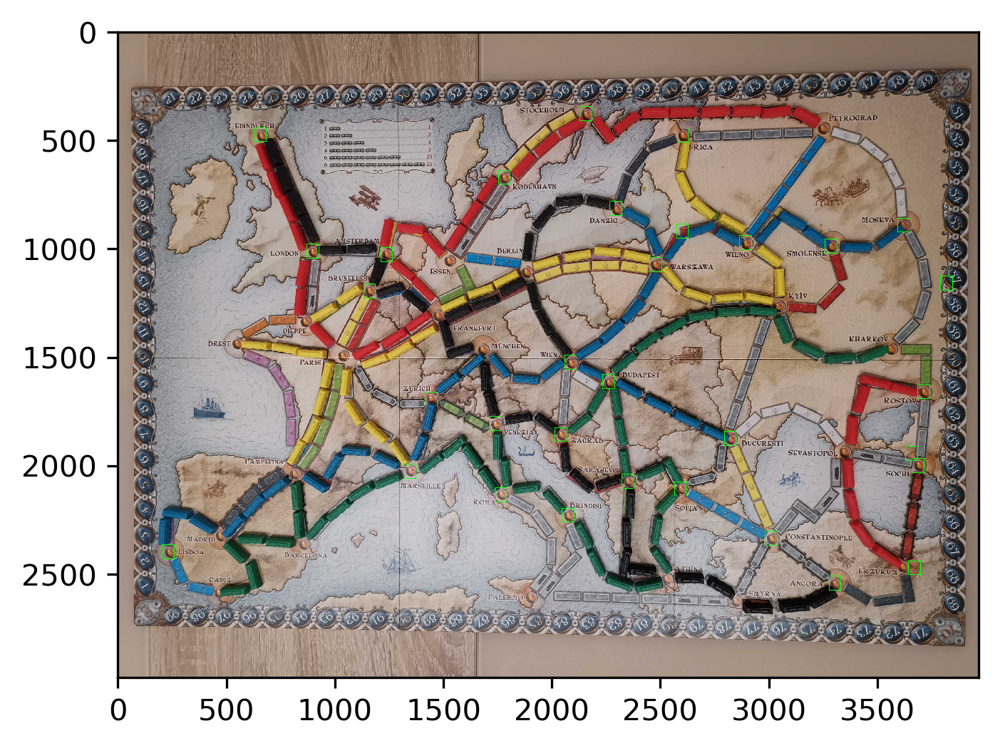

In [228]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
th=21500000
w, h = temp.shape[0:2]
for pt in points:
    pt = (pt[1],pt[0])
    print(pt)
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

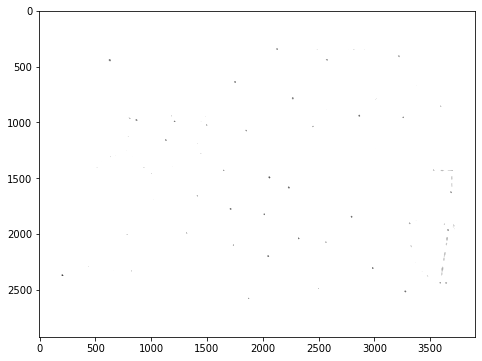

In [229]:
res = cv.matchTemplate(img2,temp,1)
min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
plot_img(res)

In [230]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
threshold = 0
w, h = temp.shape[0:2]
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

KeyboardInterrupt: 

In [ ]:
from skimage.measure import label

In [ ]:
def get_local_centers(corr,th=39000000):
    lbl, n = label(corr > th, connectivity = 1, return_num=True)
    print(lbl)
    print(n)
    return np.int16([np.mean(np.argwhere(lbl == i),axis =0) for i in range(1, n+1)])

def plot_rectangles(img, points, bbox_shape):
    points = np.int16(points)[::, ::-1]
    res_img = np.int16(img.copy())
    for pt in points:
        cv2.rectangle(res_img, (pt[0] - bbox_shape[0] // 2, pt[1] - bbox_shape[1] // 2),
                      (pt[0] + bbox_shape[0] // 2, pt[1] + bbox_shape[1] // 2), (255, 0, 0), 1)
    return res_img

In [ ]:
points = get_local_centers(res, 39000000)
points
#res = plot_rectangles(img_orig, points, template.shape)
#plot_img(res)

In [ ]:
bottom_right = (min_loc[0] + w, min_loc[1] + h)
cv.rectangle(img_g,min_loc, bottom_right, 255, 2)

plt.figure(dpi=350)
plt.subplot(121),plt.imshow(res,cmap = 'gray')
plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(img,cmap = 'gray')
plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
plt.show()

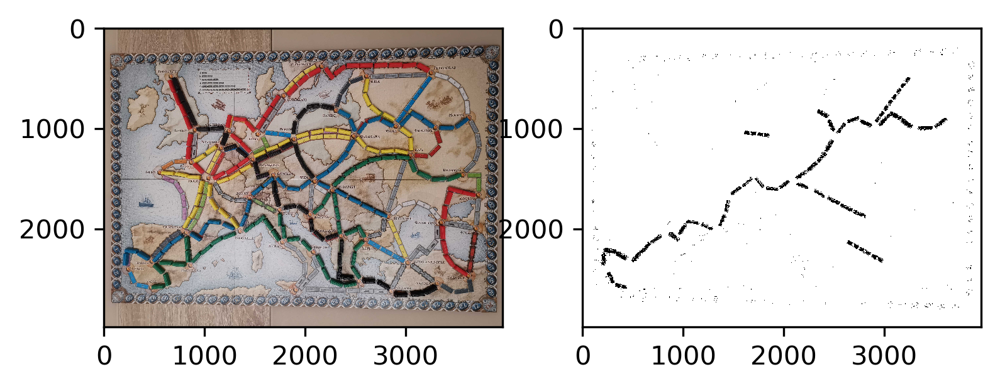

In [327]:
#blue
mask_blue = (HUE < 100) | (HUE > 102)
img2_blue = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_blue)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_blue, cmap="gray")

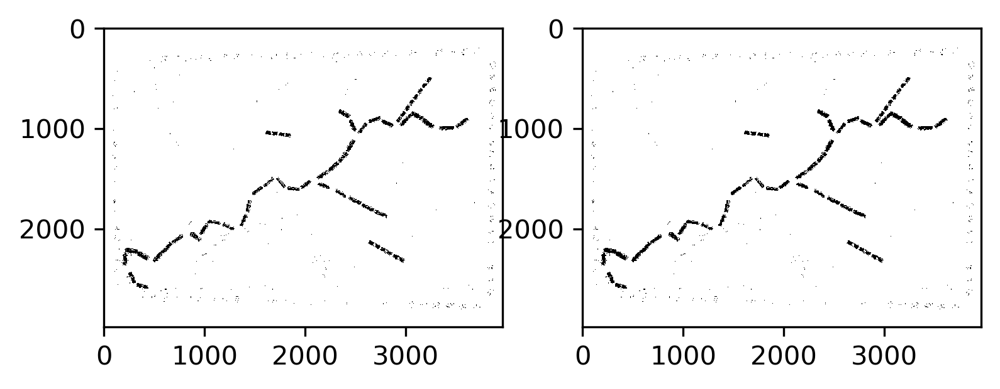

In [330]:
from skimage import morphology


mask_blue_clean = morphology.remove_small_objects(mask_blue, min_size=60, connectivity=1, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(mask_blue,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_blue_clean, cmap="gray")

In [294]:
blue_trains = sum(sum(1-mask_blue))//5200
blue_trains

39

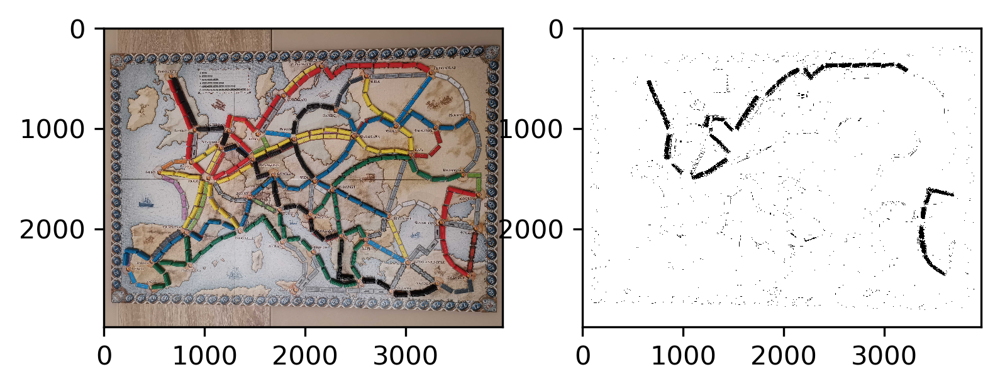

In [287]:
#red
mask_red = (HUE < 175) | (HUE > 180)
img2_red = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_red)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_red, cmap="gray")

In [291]:
red_trains = sum(sum(1-mask_red))//7000
red_trains

37

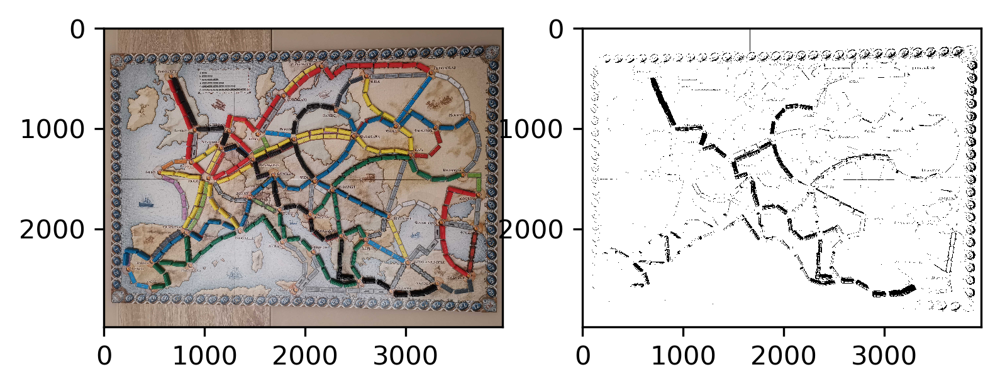

In [284]:
#black
mask_black = (LIGHT < 0) | (LIGHT > 40)
img2_black = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_black)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_black, cmap="gray")

In [286]:
black_trains = sum(sum(1-mask_black))//5300
black_trains

102

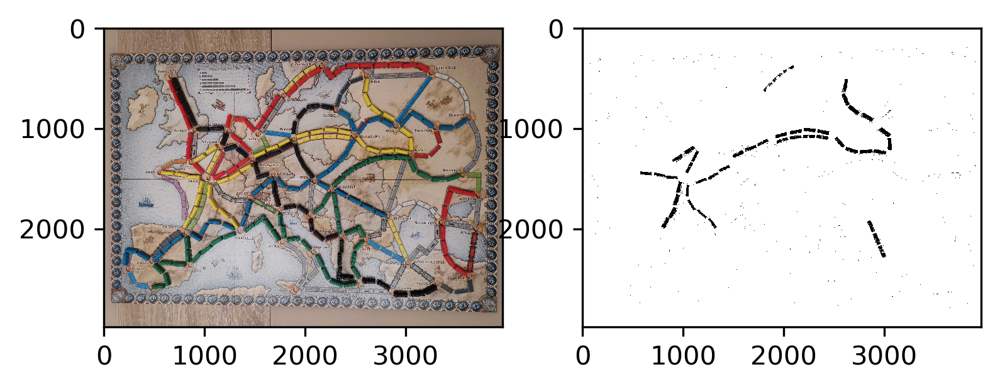

In [281]:
#yellow
mask_yellow = (HUE < 23) | (HUE > 25)
img2_yellow = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_yellow)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_yellow, cmap="gray")

In [285]:
yellow_trains = sum(sum(1-mask_yellow))//5300
yellow_trains

33

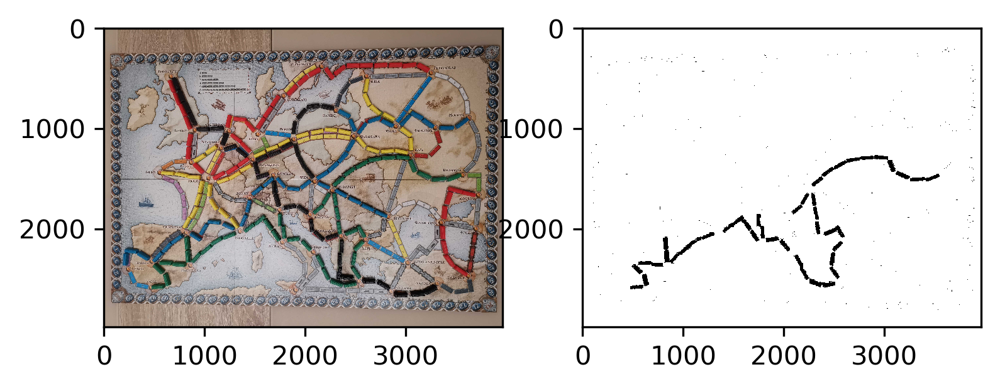

In [295]:
#green
mask_green = (HUE < 70) | (HUE > 82)
img_green = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img_green)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_green, cmap="gray")


In [275]:
print(sum(sum(1-mask_green))/43)
sum(sum(1-mask_green))

5220.046511627907


224462

In [278]:
green_trains = sum(sum(1-mask_green))//5300
green_trains

42

112


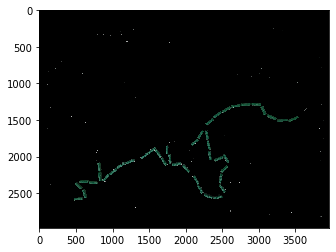

In [304]:
img_green[mask_green] =0
plt.imshow(img_green, cmap="gray")

lbl, n = label(mask_green, connectivity = 2, return_num=True)
print(n)


In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
img_rgb = cv.imread('black_blue_green.jpg')
#img_rgb = img_rgb[..., ::-1]
img_gray = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY)
template = cv.imread('template.jpg',0)
plt.imshow(template)
w, h = template.shape[::-1]
res = cv.matchTemplate(img_gray,template,cv.TM_CCOEFF_NORMED)
threshold = 0.4
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    print('g')
    img_sol = cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (252,15,192), 2)

#img_sol = img_sol[..., ::-1]
cv.imwrite('res.png',img_rgb)


In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
img_rgb = cv.imread('black_blue_green.jpg')
img_gray = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY)
template = cv.imread('template.jpg',0)
w, h = template.shape[::-1]
res = cv.matchTemplate(img_gray,template,cv.TM_CCOEFF_NORMED)
threshold = 0.4
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    print('g')
    cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)
cv.imwrite('res1.png',img_rgb)

In [ ]:
plt.hist(HUE[200:890,3200:3500]);